In [ ]:
import os.path

import matplotlib.pyplot as plt
import rasterio
import numpy as np
from skimage.util import img_as_float

In [2]:
# Define the directories containing images and shapefiles
walrus_dir = os.path.abspath("../../../")
# If this does not work replace the walrus_dir with your own path to get the data

# Create path to the image file 
image_path = os.path.join(walrus_dir, "data", "train", "clipped_images", "tor_20230801_image.tif")

In [3]:
# Open original tiff file
with rasterio.open(image_path) as original_image:
    # Get the nodata value from the metadata
    nodata_value = original_image.nodata

# Print the nodata value, should be 0.0
print("Nodata value:", nodata_value)


Nodata value: 0.0


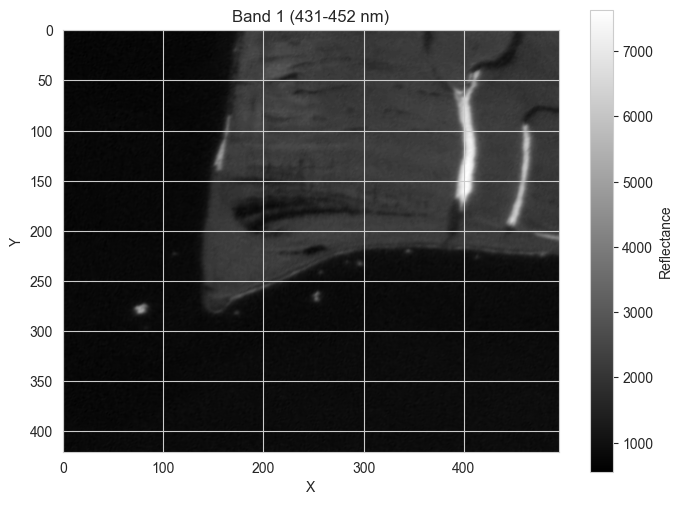

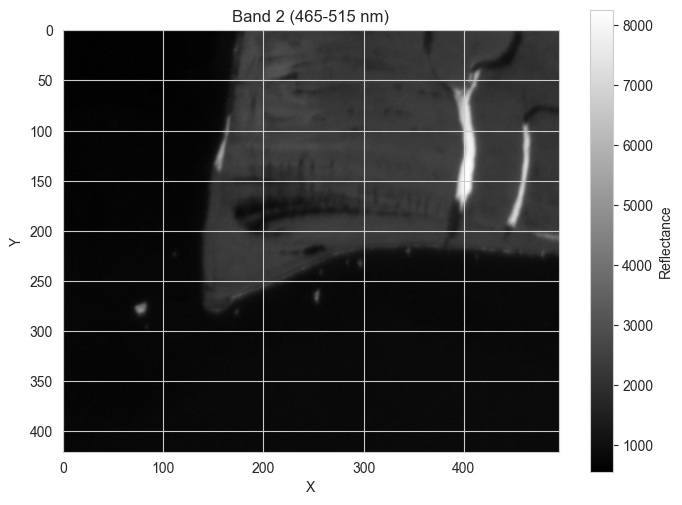

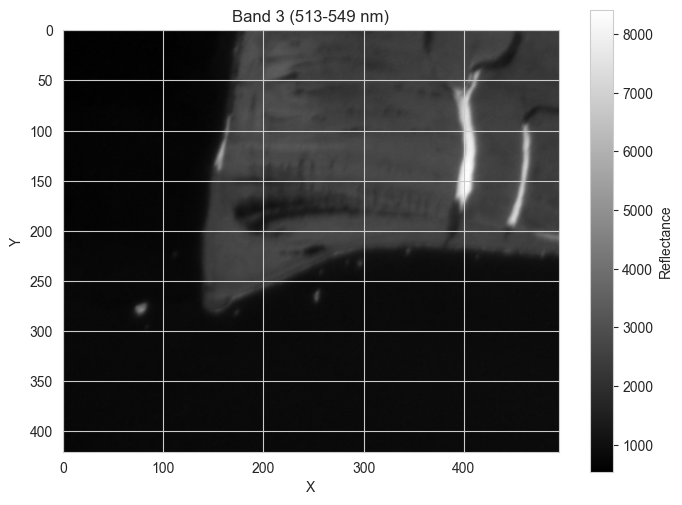

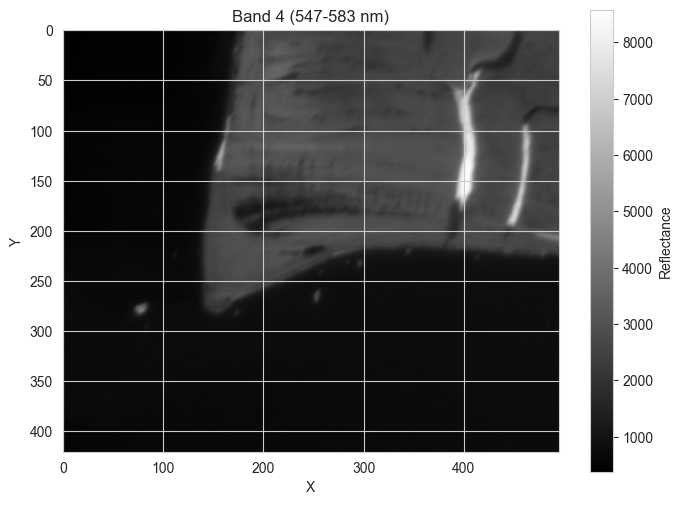

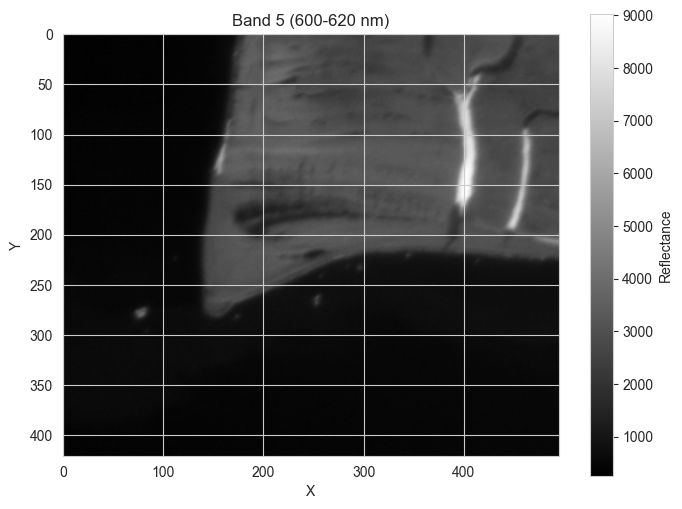

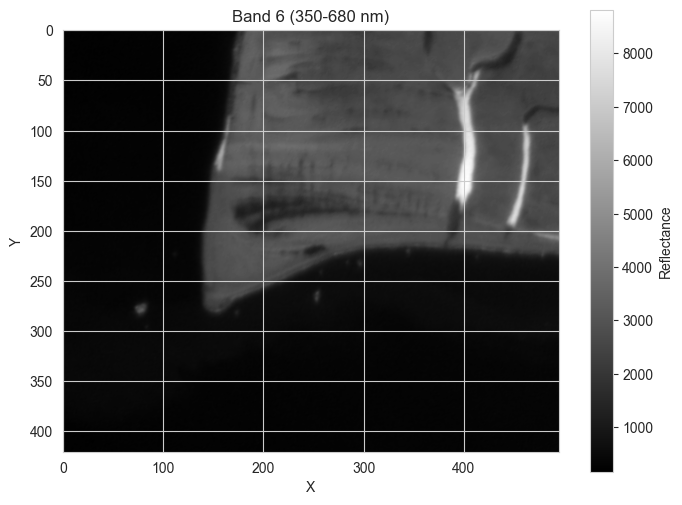

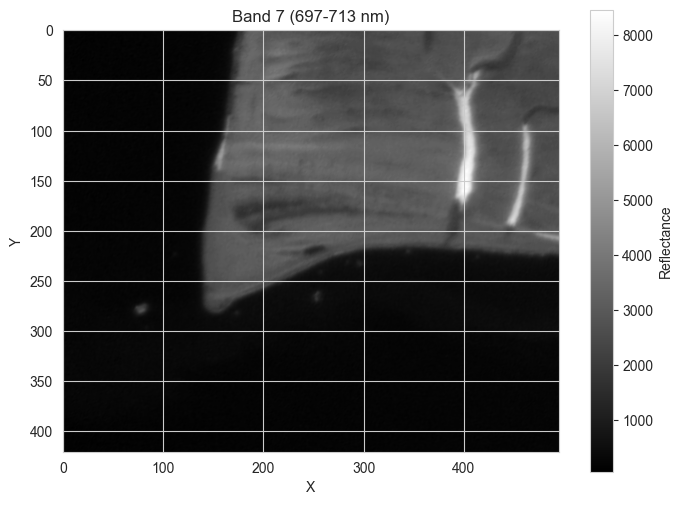

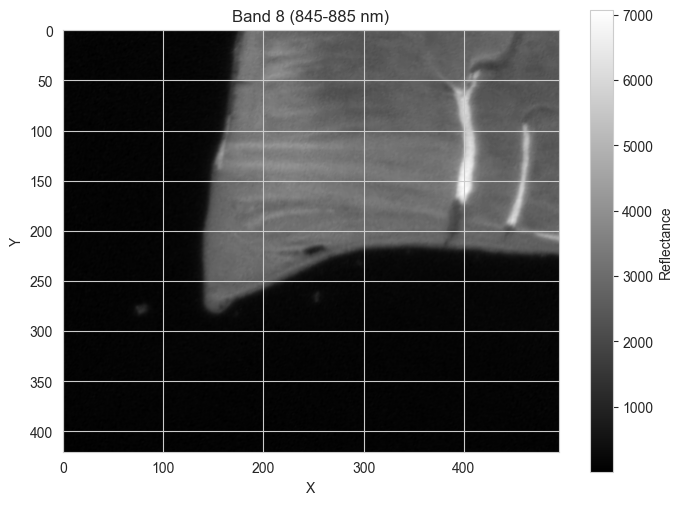

In [5]:
# Open the clipped image
with rasterio.open(image_path) as dataset:
    # Read the clipped image bands
    bands = dataset.read()

    # Wavelength ranges for each band, change depending on bands
    band_wavelengths = {
        'Band 1': (431, 452),  # Coatal Blue
        'Band 2': (465, 515),  # blue
        'Band 3': (513, 549),  # gren 1
        'Band 4': (547, 583),   # green
        'Band 5': (600, 620),  #yellow
        'Band 6': (350, 680),  # red
        'Band 7': (697, 713),  # redegdeg
        'Band 8': (845, 885)   # NIR
    }

    # Plot each band separately
    for band, (min_wavelength, max_wavelength) in band_wavelengths.items():
        plt.figure(figsize=(8, 6))
        plt.imshow(bands[int(band.split()[1]) - 1], cmap='gray')
        plt.title(f'{band} ({min_wavelength}-{max_wavelength} nm)')
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.colorbar(label='Reflectance')
        plt.show()


In [7]:
# Get values for Band 1
band1_values = bands[0]

# Display shape of the Band 1 array
print("Shape of Band 1 array:", band1_values.shape)

# Display Band 1 array
print("Band 1 values:\n", band1_values)

Shape of Band 1 array: (421, 495)
Band 1 values:
 [[ 672  721  696 ... 2219 2220 2217]
 [ 659  716  648 ... 2233 2229 2220]
 [ 648  669  607 ... 2239 2227 2214]
 ...
 [ 773  717  805 ...  929  904  884]
 [ 772  766  810 ...  966  878  836]
 [ 764  766  751 ...  964  850  876]]


In [11]:
clipped_image = image_path
clipped_image_path = image_path

Min Value: 1
Max Value: 9029
Mean Value: 1389.141661868087


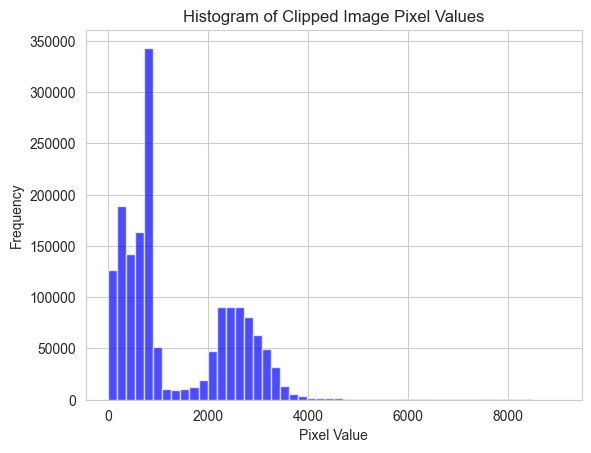

In [9]:
with rasterio.open(image_path) as src:
    # Read the image data
    clipped_image = src.read()

# Calculate min, max, and mean values
min_value = clipped_image.min()
max_value = clipped_image.max()
mean_value = clipped_image.mean()

# Print statistics
print("Min Value:", min_value)
print("Max Value:", max_value)
print("Mean Value:", mean_value)

# Plot histogram
plt.hist(clipped_image.flatten(), bins=50, color='blue', alpha=0.7)
plt.title("Histogram of Clipped Image Pixel Values")
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

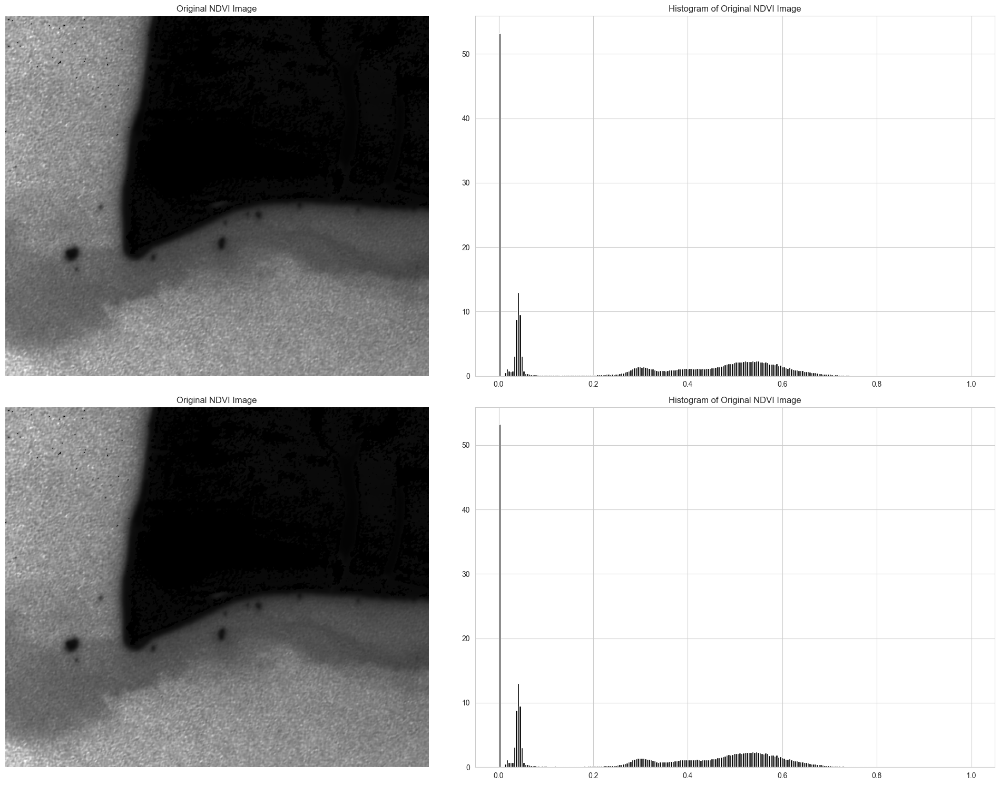

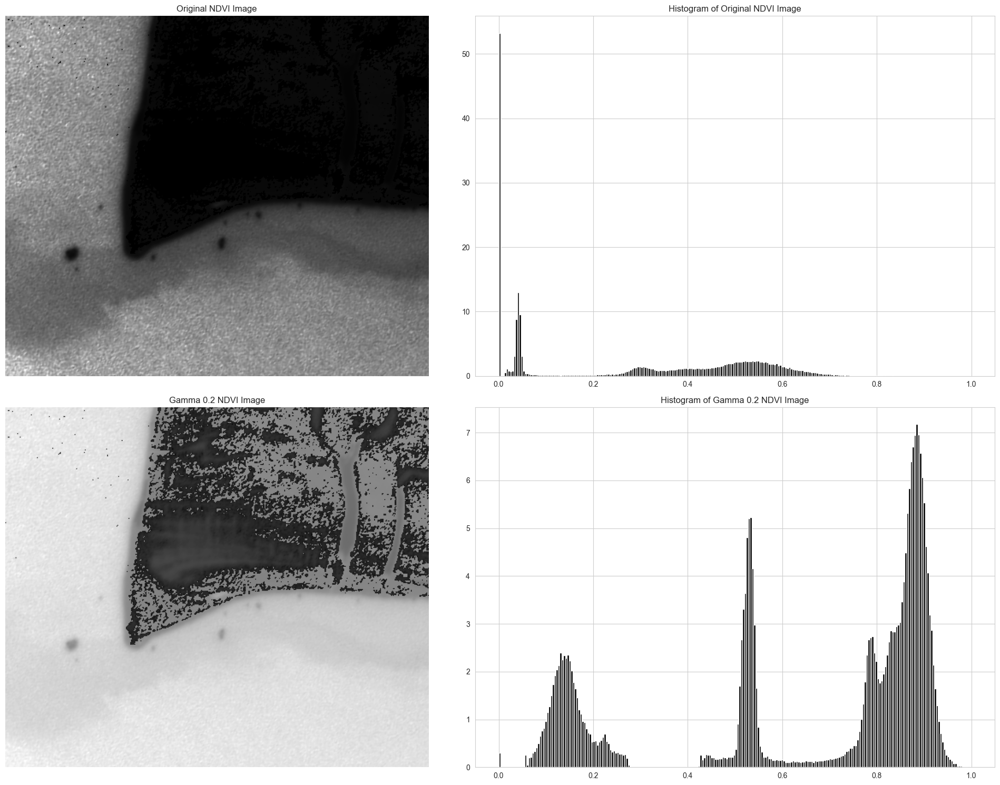

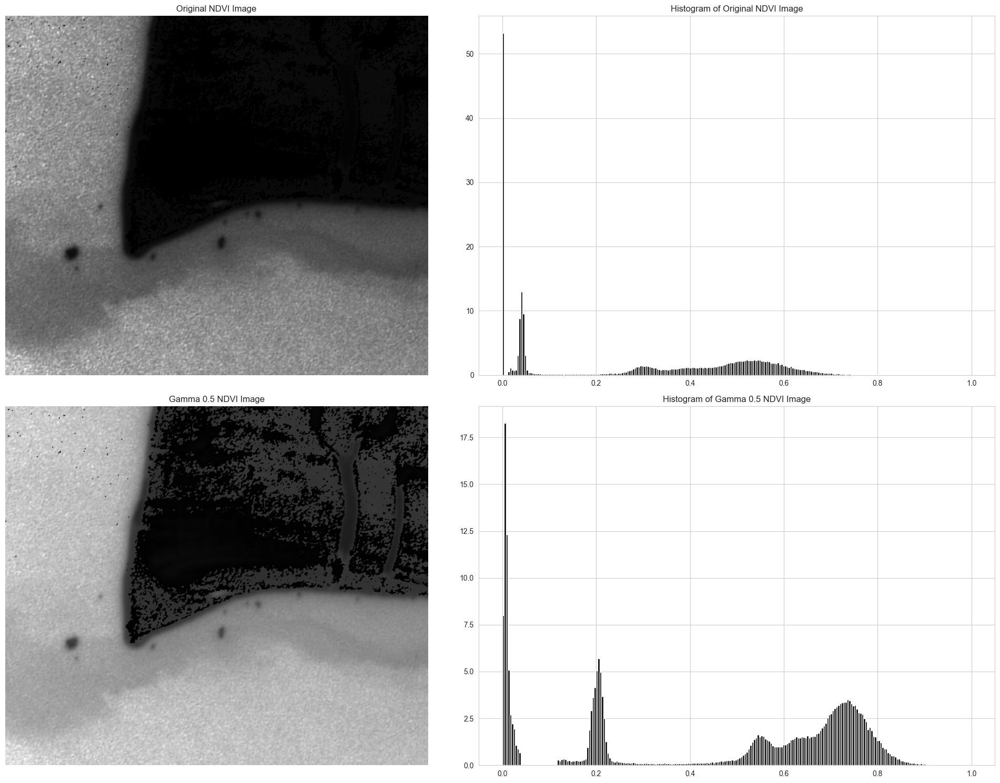

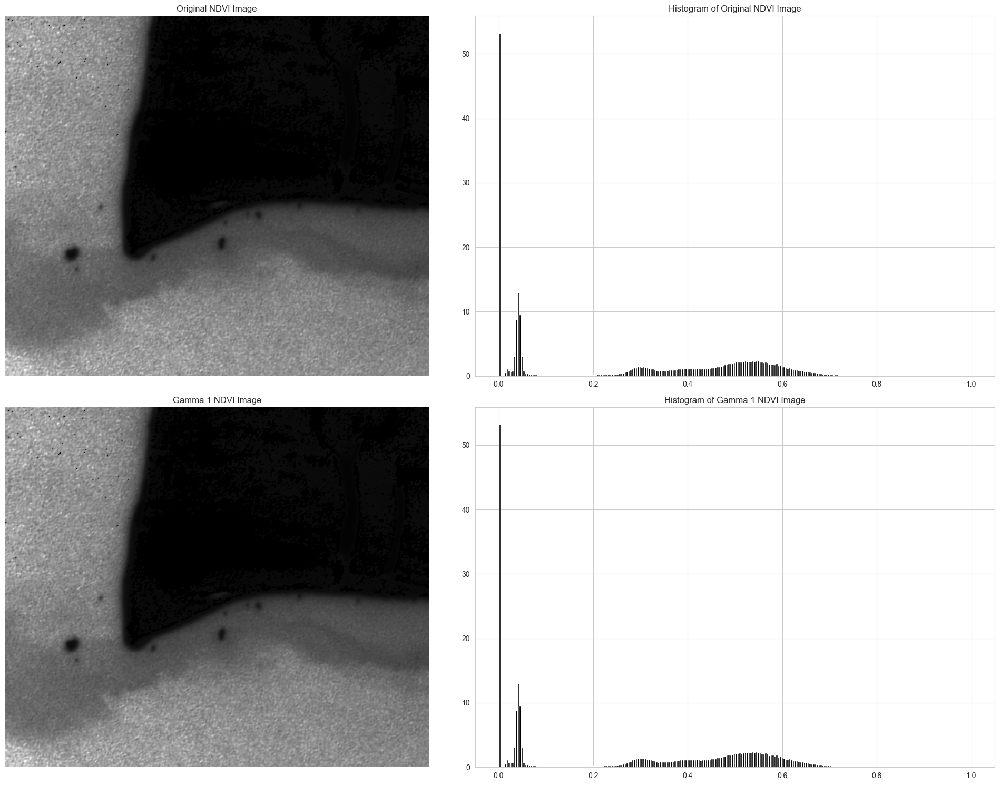

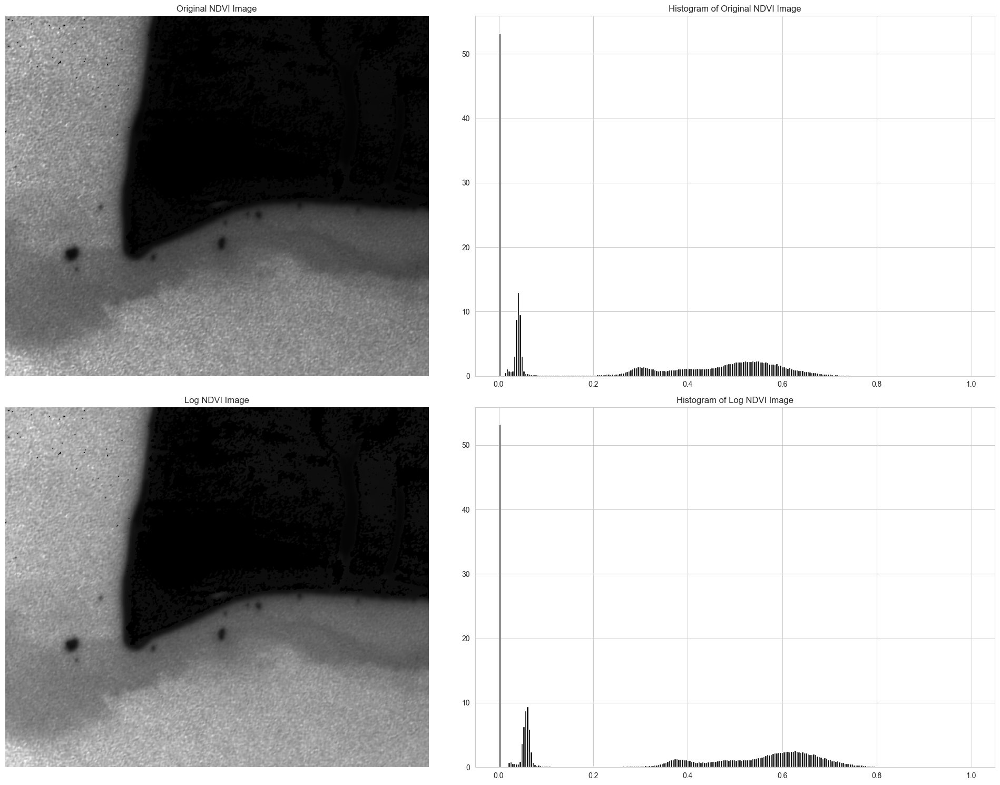

...

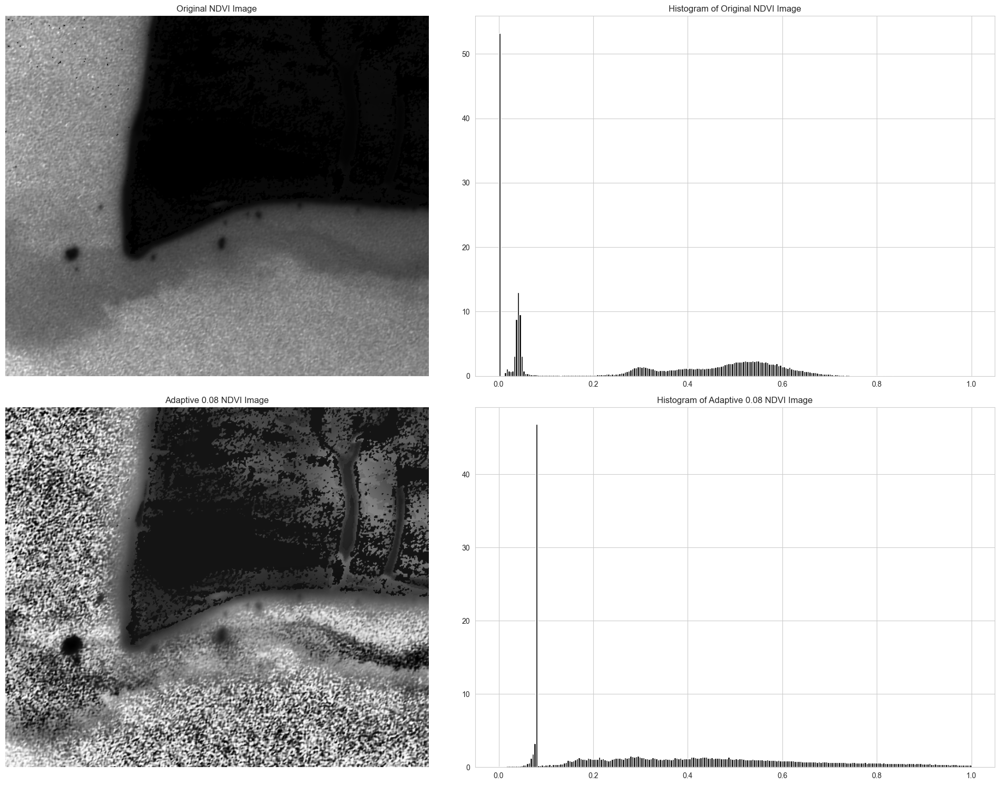

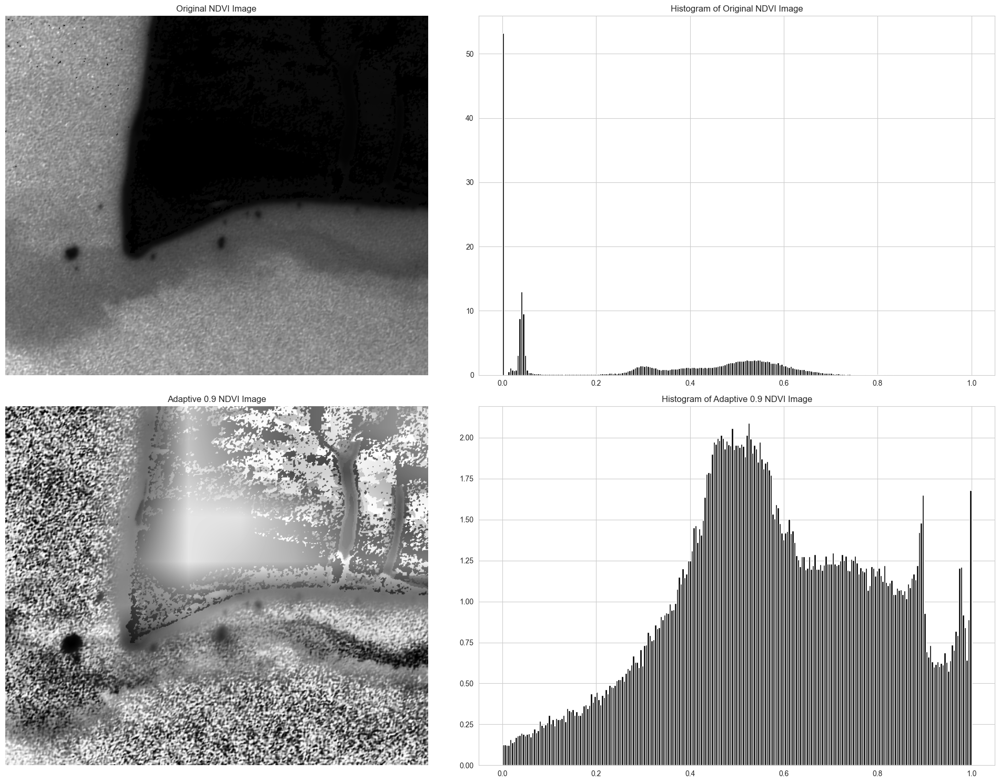

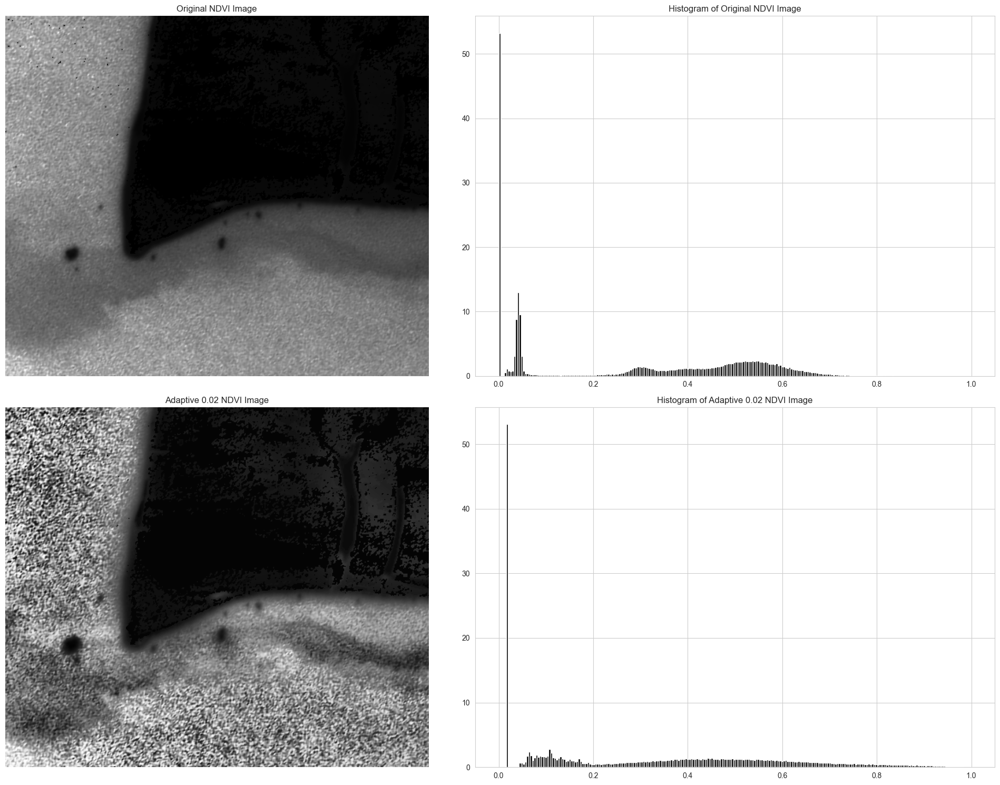

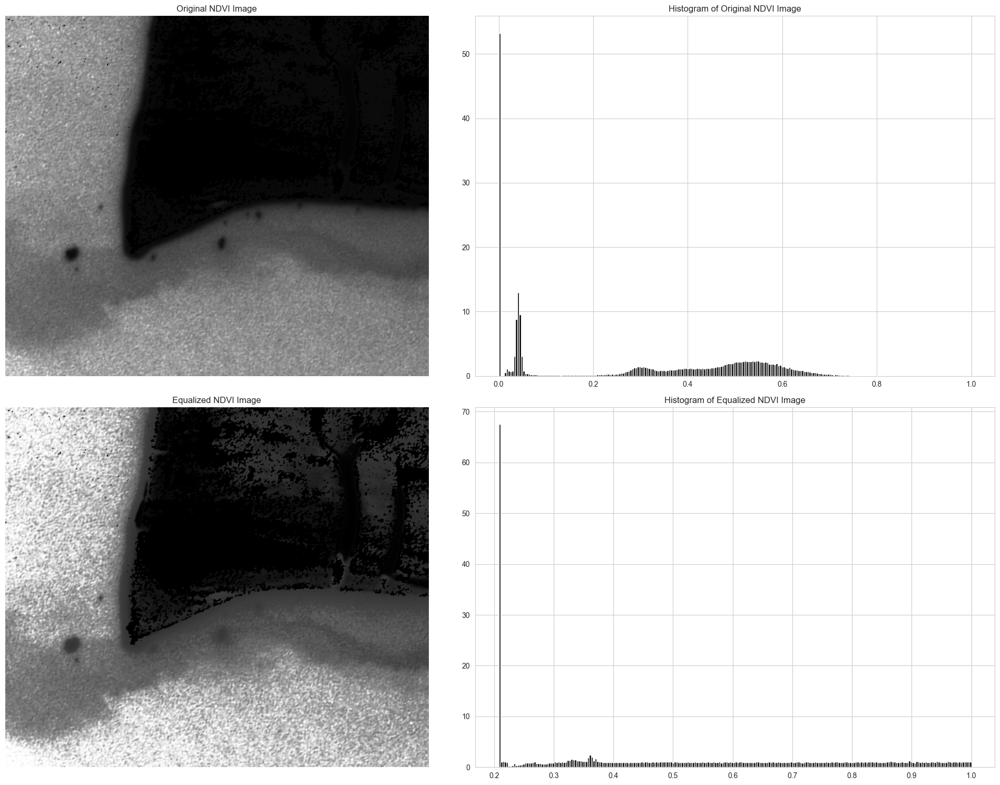

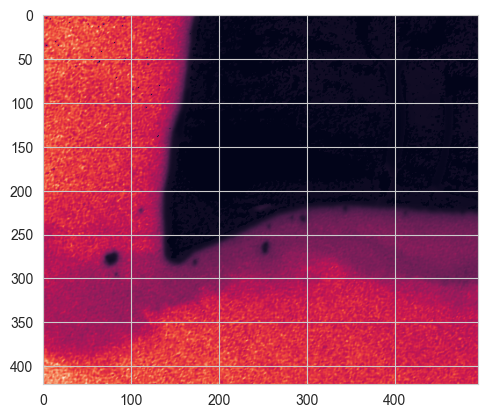

In [27]:
import rasterio
import matplotlib.pyplot as plt
from rasterio.plot import show
from skimage import exposure, img_as_float

# Path to your single TIFF image
single_tiff_path = image_path

# Open the single TIFF image
with rasterio.open(single_tiff_path) as dataset:
    # Read the entire image (all bands)
    bands = dataset.read()

    # Define which bands to use for NDVI calculation
    # Adjust these indices based on your specific image bands
    nir_band_index = 7  # 0-based index for Band 8 as NIR
    red_band_index = 5  # 0-based index for Band 6 as Red

    # Extract the NIR and Red bands
    nir_band = bands[nir_band_index]
    red_band = bands[red_band_index]

    # Calculate NDVI
    ndvi = (nir_band - red_band) / (nir_band + red_band)

    # Convert NDVI to float if not already done
    ndvi_normalized = img_as_float(ndvi)

    # Ensure NDVI is within [0, 1] range
    ndvi_normalized = exposure.rescale_intensity(ndvi_normalized)

    # Apply various exposure adjustments
    gammaEn1 = exposure.adjust_gamma(ndvi_normalized, gamma=0.2, gain=1)
    gammaEn2 = exposure.adjust_gamma(ndvi_normalized, gamma=0.5, gain=1)
    gammaEn3 = exposure.adjust_gamma(ndvi_normalized, gamma=1, gain=1)
    logEn1 = exposure.adjust_log(ndvi_normalized, gain=1, inv=False)
    logEn2 = exposure.adjust_log(ndvi_normalized, gain=1, inv=True)
    sigmoidEn1 = exposure.adjust_sigmoid(ndvi_normalized, cutoff=0.5, gain=10, inv=False)
    sigmoidEn2 = exposure.adjust_sigmoid(ndvi_normalized, cutoff=0.9, gain=10, inv=False)
    sigmoidEn3 = exposure.adjust_sigmoid(ndvi_normalized, cutoff=0.05, gain=10, inv=False)
    sigmoidEn4 = exposure.adjust_sigmoid(ndvi_normalized, cutoff=0.1, gain=5, inv=True)

    # Apply adaptive histogram equalization
    adaptiveEn1 = exposure.equalize_adapthist(ndvi_normalized, clip_limit=0.08, nbins=256)
    adaptiveEn2 = exposure.equalize_adapthist(ndvi_normalized, clip_limit=0.9, nbins=256)
    adaptiveEn3 = exposure.equalize_adapthist(ndvi_normalized, clip_limit=0.02, nbins=256)
    equalizeEn = exposure.equalize_hist(ndvi_normalized, nbins=256, mask=None)

    # Plotting each enhancement
    enhancements = {
        'Original': ndvi_normalized,
        'Gamma 0.2': gammaEn1,
        'Gamma 0.5': gammaEn2,
        'Gamma 1': gammaEn3,
        'Log': logEn1,
        'Inverse Log': logEn2,
        'Sigmoid 0.5': sigmoidEn1,
        'Sigmoid 0.9': sigmoidEn2,
        'Sigmoid 0.05': sigmoidEn3,
        'Sigmoid 0.1': sigmoidEn4,
        'Adaptive 0.08': adaptiveEn1,
        'Adaptive 0.9': adaptiveEn2,
        'Adaptive 0.02': adaptiveEn3,
        'Equalized': equalizeEn
    }

    for title, image in enhancements.items():
        fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 15))

        # Original NDVI image and its histogram
        ax[0, 0].imshow(ndvi_normalized, cmap='gray')
        ax[0, 0].set_title('Original NDVI Image')
        ax[0, 0].axis('off')
        ax[0, 1].hist(ndvi_normalized.ravel(), bins=256, density=True, histtype='bar', color='black')
        ax[0, 1].ticklabel_format(style='plain')
        ax[0, 1].set_title('Histogram of Original NDVI Image')

        # Enhanced image and its histogram
        ax[1, 0].imshow(image, cmap='gray')
        ax[1, 0].set_title(f'{title} NDVI Image')
        ax[1, 0].axis('off')
        ax[1, 1].hist(image.ravel(), bins=256, density=True, histtype='bar', color='black')
        ax[1, 1].ticklabel_format(style='plain')
        ax[1, 1].set_title(f'Histogram of {title} NDVI Image')

        plt.tight_layout()
        plt.show()

    # Optionally, show the original NDVI image
    show(ndvi_normalized)



In [ ]:
    # Create an empty dictionary to store band arrays
    band_arrays = {}
    # Iterate over each band
    for band, (min_wavelength, max_wavelength) in band_wavelengths.items():
        # Extract the band index from the band name
        band_index = int(band.split()[1]) - 1
        
        # Extract the band array
        band_array = bands[band_index]
        
        # Store the band array in the dictionary
        band_arrays[band] = band_array

In [24]:


# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read clipped image bands
    bands = dataset.read()

    # Wavelength ranges for each band, change depending on bands
    band_wavelengths = {
        'Band 1': (431, 452),  # Coatal Blue
        'Band 2': (465, 515),  # blue
        'Band 3': (513, 549),  # gren 1
        'Band 4': (547, 583),   # green
        'Band 5': (600, 620),  #yellow
        'Band 6': (350, 680),  # red
        'Band 7': (697, 713),  # redegdeg
        'Band 8': (845, 885)   # NIR
    }

    # Iterate over each band
    for band, (min_wavelength, max_wavelength) in band_wavelengths.items():
        # Extract the band index from the band name
        band_index = int(band.split()[1]) - 1
        
        # Extract the band array
        band_array = bands[band_index]
        
        # Store the band array in the dictionary
        band_arrays[band] = band_array

# Now, band_arrays dictionary contains arrays for each band
# Can access each band array using band_arrays['Band 1'], band_arrays['Band 2'], etc.


In [17]:
# Create an empty dictionary to store band arrays
band_arrays = {}

# Open the clipped image with rasterio
with rasterio.open(clipped_image_path) as dataset:
    # Read all bands from the clipped image
    bands = dataset.read()

    # Iterate over each band
    for band_index in range(bands.shape[0]):
        # Extract the band array
        band_array = bands[band_index]

        # Convert the band array to float
        band_array_float = img_as_float(band_array)

        # Store the band array in the dictionary
        band_name = f'Band {band_index + 1}'
        band_arrays[band_name] = band_array_float

# Now, band_arrays dictionary contains arrays for each band converted to float
# You can access each band array using band_arrays['Band 1'], band_arrays['Band 2'], etc.


In [14]:
# Assuming you have Band 6 (Red) and Band 8 (NIR)
red = band_arrays['Band 6']  # Red band
nir = band_arrays['Band 8']  # NIR band

# Calculate NDVI
ndvi = (nir - red) / (nir + red + 1e-9)  # Adding a small value (1e-9) to avoid division by zero

# Add NDVI to band_arrays
band_arrays['NDVI'] = ndvi


In [ ]:
# Define the enhancements to iterate over
enhancements = {
    'Original': ndvi,
    'Gamma 0.2': gammaEn1,
    'Gamma 0.5': gammaEn2,
    'Gamma 1': gammaEn3,
    'Log': logEn1,
    'Inverse Log': logEn2,
    'Sigmoid 0.5': sigmoidEn1,
    'Sigmoid 0.9': sigmoidEn2,
    'Sigmoid 0.05': sigmoidEn3,
    'Sigmoid 0.1': sigmoidEn4,
    'Adaptive 0.08': adaptiveEn1,
    'Adaptive 0.9': adaptiveEn2,
    'Adaptive 0.02': adaptiveEn3,
    'Equalized': equalizeEn
}

# Plotting each enhancement
for title, image in enhancements.items():
    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 15))
    
    # Original image and its histogram
    ax[0, 0].imshow(ndvi, cmap='gray')
    ax[0, 0].set_title('Original Image')
    ax[0, 0].axis('off')
    ax[0, 1].hist(ndvi.ravel(), bins=256, density=True, histtype='bar', color='black')
    ax[0, 1].ticklabel_format(style='plain')
    ax[0, 1].set_title('Histogram of Original Image')
    
    # Enhanced image and its histogram
    ax[1, 0].imshow(image, cmap='gray')
    ax[1, 0].set_title(f'{title} Image')
    ax[1, 0].axis('off')
    ax[1, 1].hist(image.ravel(), bins=256, density=True, histtype='bar', color='black')
    ax[1, 1].ticklabel_format(style='plain')
    ax[1, 1].set_title(f'Histogram of {title} Image')
    
    plt.tight_layout()
    plt.show()


In [25]:
clipped_image_path = image_path
# Assuming you have Band 6 (Red) and Band 8 (NIR)
red = band_arrays['Band 6']  # Red band
nir = band_arrays['Band 8']  # NIR band

# Calculate NDVI
ndvi = (nir - red) / (nir + red + 1e-9)  # Adding a small value (1e-9) to avoid division by zero

# Add NDVI to band_arrays
band_arrays['NDVI'] = ndvi
ndvi_path = ndvi


In [ ]:
# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read Bands from the clipped image
    coast_blue  = dataset.read(1)
    green = dataset.read(2)
    red   = dataset.read(3)
    NIR   = dataset.read(4)
    
    
    
    
    band_wavelengths = {
        'Band 1': (431, 452),  # Coatal Blue
        'Band 2': (465, 515),  # blue
        'Band 3': (513, 549),  # gren 1
        'Band 4': (547, 583),   # green
        'Band 5': (600, 620),  #yellow
        'Band 6': (350, 680),  # red
        'Band 7': (697, 713),  # redegdeg
        'Band 8': (845, 885)   # NIR
    }

In [28]:
NB8 = (B8 - np.min(B8)) / (np.max(B8) - np.min(B8))
NB7 = (B7 - np.min(B7)) / (np.max(B7) - np.min(B7))
NB6 = (B6 - np.min(B6)) / (np.max(B6) - np.min(B6))
NB5 = (B5 - np.min(B5)) / (np.max(B5) - np.min(B5))
NB4 = (B4 - np.min(B4)) / (np.max(B4) - np.min(B4))
NB3 = (B3 - np.min(B3)) / (np.max(B3) - np.min(B3))
NB2 = (B2 - np.min(B2)) / (np.max(B2) - np.min(B2))
NB1 = (B1 - np.min(B1)) / (np.max(B1) - np.min(B1))

NameError: name 'B8' is not defined

In [1]:
import rasterio
from rasterio.plot import show
from rasterio.mask import mask
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
import skimage as skm
from skimage import exposure, img_as_float

In [4]:
# Create path to the image file 
image_path = "C:\\Users\\Student\\Documents\\101_walrus_mres\\planet_skysat_pairs\\planet_skysat_pairs\\torellneset_skysatscene_pansharpened_udm2\\SkySatScene\\20230825_104320_ssc13d3_0006_pansharpened_clip.tif"

# Create path to the shapefile 
shape_path = "C:\\Users\\Student\\Documents\\101_walrus_mres\\GIS\\torellneset_clip_825.shp"

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


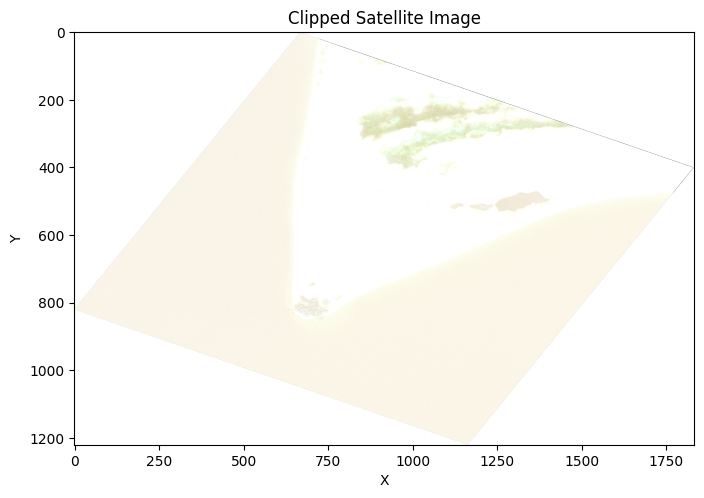

In [10]:
# Function to clip the image by shape
def clip_image(image_path, shape_path):
    # Read the shapefile
    shapefile = gpd.read_file(shape_path)
    # Open the satellite image
    with rasterio.open(image_path) as src:
        # Clip the image
        clipped_image, clipped_transform = mask(src, shapefile.geometry, crop=True)
        # Get metadata of the clipped image
        clipped_meta = src.meta.copy()
        clipped_meta.update({"driver": "GTiff",
                             "height": clipped_image.shape[1],
                             "width": clipped_image.shape[2],
                             "transform": clipped_transform})
    return clipped_image, clipped_meta

# File path to the satellite image (TIF file, not the clip.tiff)
image_path = "C:\\Users\\Student\\Documents\\101_walrus_mres\\planet_skysat_pairs\\planet_skysat_pairs\\torellneset_skysatscene_pansharpened_udm2\\SkySatScene\\20230825_104320_ssc13d3_0006_pansharpened_clip.tif"

# Create path to the shapefile 
shape_path = "C:\\Users\\Student\\Documents\\101_walrus_mres\\GIS\\torellneset_clip_825.shp"

# Clip the image
clipped_image, clipped_meta = clip_image(image_path, shape_path)

# Plot the clipped image
plt.figure(figsize=(8, 6))
plt.imshow(clipped_image.transpose(1, 2, 0))  # Transpose to (height, width, bands) for visualization
plt.title('Clipped Satellite Image')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

Meta data and data test for saving


In [12]:

# Open original tiff file
with rasterio.open(image_path) as original_image:
    # Get the nodata value from the metadata
    nodata_value = original_image.nodata

# Print the nodata value, should be 0.0
print("Nodata value:", nodata_value)


Nodata value: 0.0


In [13]:
# Open original tiff file
with rasterio.open(image_path) as src:
    # Get the CRS of the original raster
    original_crs = src.crs
print(original_crs)
    

EPSG:32634


In [14]:
import rasterio
from rasterio import Affine

# Define the file path to save the clipped image
clipped_image_path = "C:\\Users\\Student\\Documents\\101_walrus_mres\\GIS\\torellneset_clipped_825.tif"

# Get metadata from the original raster
meta = original_image.meta

# Update metadata with the CRS and nodata value
meta.update({
    'crs': original_crs,
    'nodata': nodata_value
})

# Save clipped image to the specified file path
with rasterio.open(clipped_image_path, 'w', **meta) as dst:
    dst.write(clipped_image)


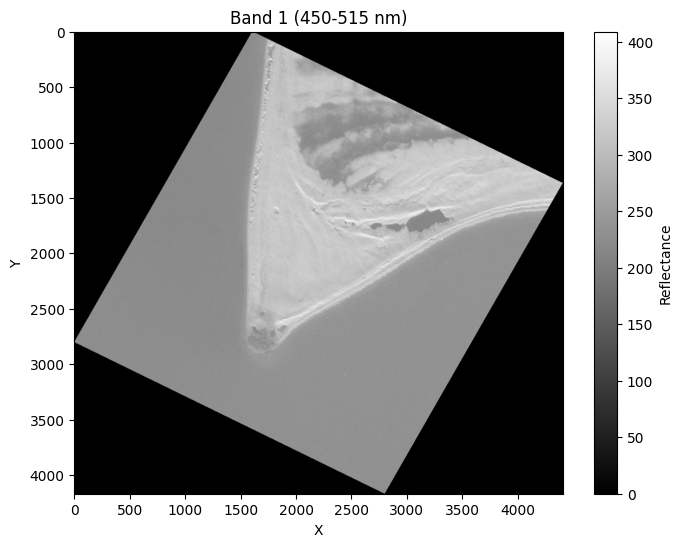

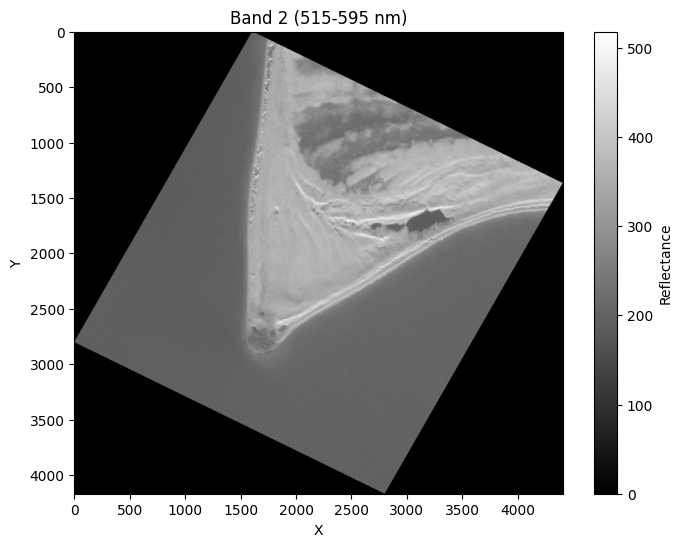

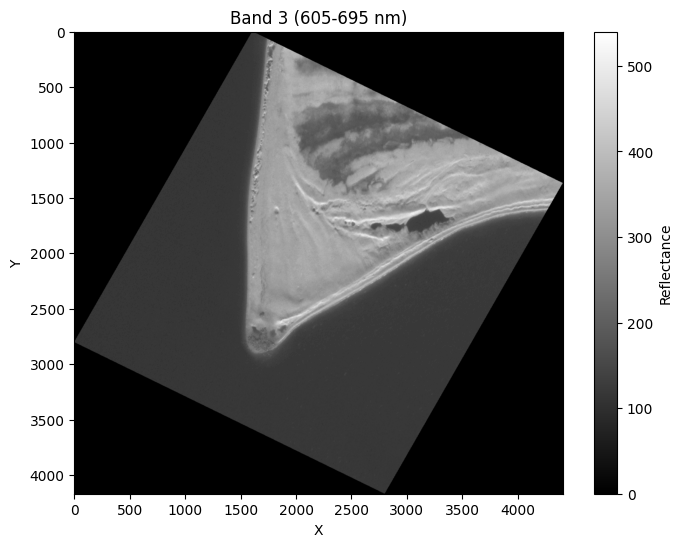

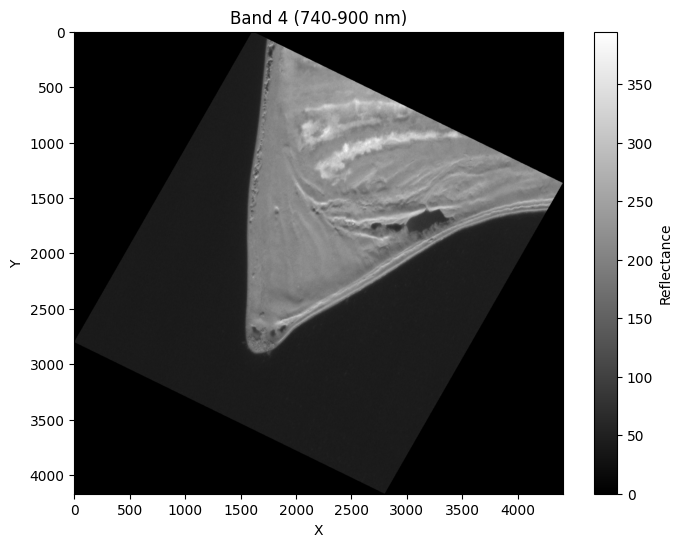

In [19]:
# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read the clipped image bands
    bands = dataset.read()

    # Wavelength ranges for each band, change depending on bands
    band_wavelengths = {
        'Band 1': (450, 515),  # Blue
        'Band 2': (515, 595),  # Green
        'Band 3': (605, 695),  # Red
        'Band 4': (740, 900)   # NIR
    }

    # Plot each band separately
    for band, (min_wavelength, max_wavelength) in band_wavelengths.items():
        plt.figure(figsize=(8, 6))
        plt.imshow(bands[int(band.split()[1]) - 1], cmap='gray')
        plt.title(f'{band} ({min_wavelength}-{max_wavelength} nm)')
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.colorbar(label='Reflectance')
        plt.show()


This is me trying more image enhancement 

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import skimage as skm
from skimage import exposure, img_as_float

In [20]:
# Get values for Band 1
band1_values = bands[0]

# Display shape of the Band 1 array
print("Shape of Band 1 array:", band1_values.shape)

# Display Band 1 array
print("Band 1 values:\n", band1_values)


Shape of Band 1 array: (4170, 4410)
Band 1 values:
 [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


For All the bands 

Min Value: 0
Max Value: 540
Mean Value: 113.12187708336732


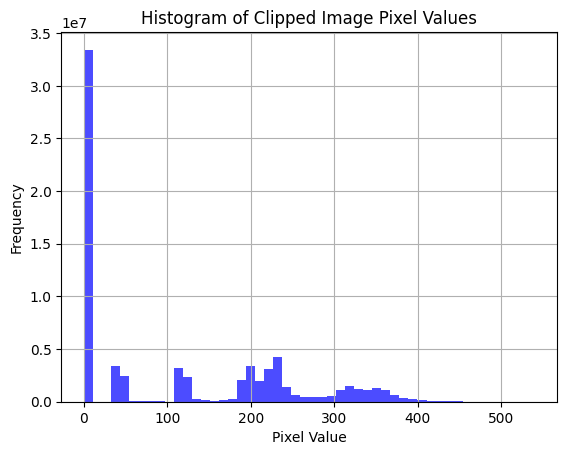

In [11]:
with rasterio.open(clipped_image_path) as src:
    # Read the image data
    clipped_image = src.read()

# Calculate min, max, and mean values
min_value = clipped_image.min()
max_value = clipped_image.max()
mean_value = clipped_image.mean()

# Print statistics
print("Min Value:", min_value)
print("Max Value:", max_value)
print("Mean Value:", mean_value)

# Plot histogram
plt.hist(clipped_image.flatten(), bins=50, color='blue', alpha=0.7)
plt.title("Histogram of Clipped Image Pixel Values")
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


Band 1 Statistics:
Min Value: 0
Max Value: 409
Mean Value: 141.4918527219041


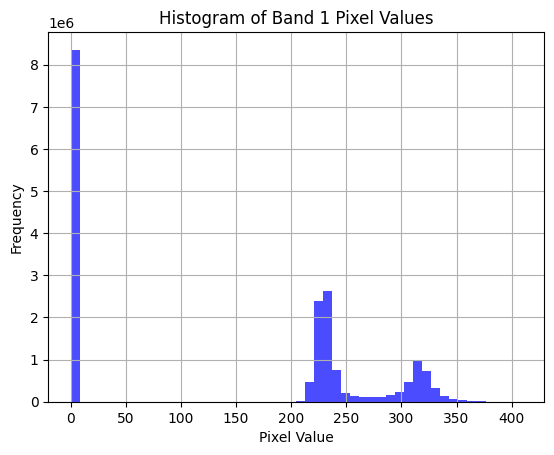

In [21]:
# Get the values for Band 1
band1_values = bands[0]

# Calculate statistics for Band 1
min_value_band1 = np.min(band1_values)
max_value_band1 = np.max(band1_values)
mean_value_band1 = np.mean(band1_values)

# Print statistics for Band 1
print("Band 1 Statistics:")
print(f"Min Value: {min_value_band1}")
print(f"Max Value: {max_value_band1}")
print(f"Mean Value: {mean_value_band1}")



# Plot histogram of Band 1 pixel values
plt.hist(band1_values.flatten(), bins=50, color='blue', alpha=0.7)
plt.title("Histogram of Band 1 Pixel Values")
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


Band 1 Statistics:
Min Value: 0
Max Value: 518
Mean Value: 139.5869355525844


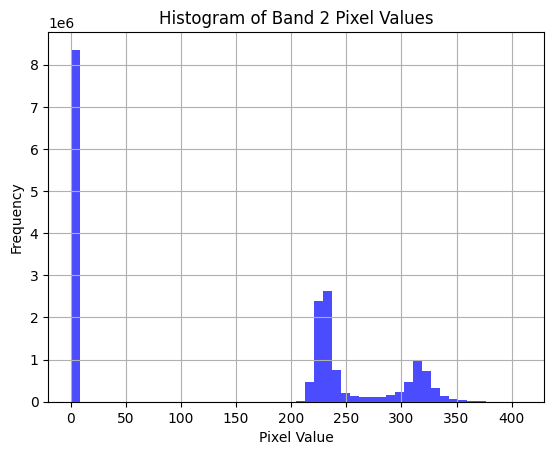

In [22]:
# Get values for Band 2
band2_values = clipped_image[1]                                      # Remember indexing formatting

# Calculate min, max, and mean values for Band 
min_value_band2 = band2_values.min()
max_value_band2 = band2_values.max()
mean_value_band2 = band2_values.mean()

# Print statistics for Band 
print("Band 1 Statistics:")
print(f"Min Value: {min_value_band2}")
print(f"Max Value: {max_value_band2}")
print(f"Mean Value: {mean_value_band2}")

# Plot histogram of Band pixel values
plt.hist(band1_values.flatten(), bins=50, color='blue', alpha=0.7)
plt.title("Histogram of Band 2 Pixel Values")
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

In [23]:
import numpy as np
from skimage import exposure, img_as_float

# Create an empty dictionary to store band arrays
band_arrays = {}

# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read clipped image bands
    bands = dataset.read()

    # Wavelength ranges for each band, remember to change depending on source image
    band_wavelengths = {
        'Band 1': (450, 515),  # Blue
        'Band 2': (515, 595),  # Green
        'Band 3': (605, 695),  # Red
        'Band 4': (740, 900)   # NIR
    }

    # Iterate over each band
    for band, (min_wavelength, max_wavelength) in band_wavelengths.items():
        # Extract the band index from the band name
        band_index = int(band.split()[1]) - 1
        
        # Extract the band array
        band_array = bands[band_index]
        
        # Store the band array in the dictionary
        band_arrays[band] = band_array

# Now, band_arrays dictionary contains arrays for each band
# Can access each band array using band_arrays['Band 1'], band_arrays['Band 2'], etc.


example 

In [15]:
band_arrays['Band 1']

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

In [16]:
# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read Band 1 from the clipped image
    band1 = dataset.read(1)

# Now 'band1' contains the array for Band 1


In [76]:
band1

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

In [17]:
# Check the data type of band1
print("Data type of band1:", band1.dtype)


Data type of band1: uint16


In [18]:
img = img_as_float(band1)
img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

Testing image manipulation and pixel values

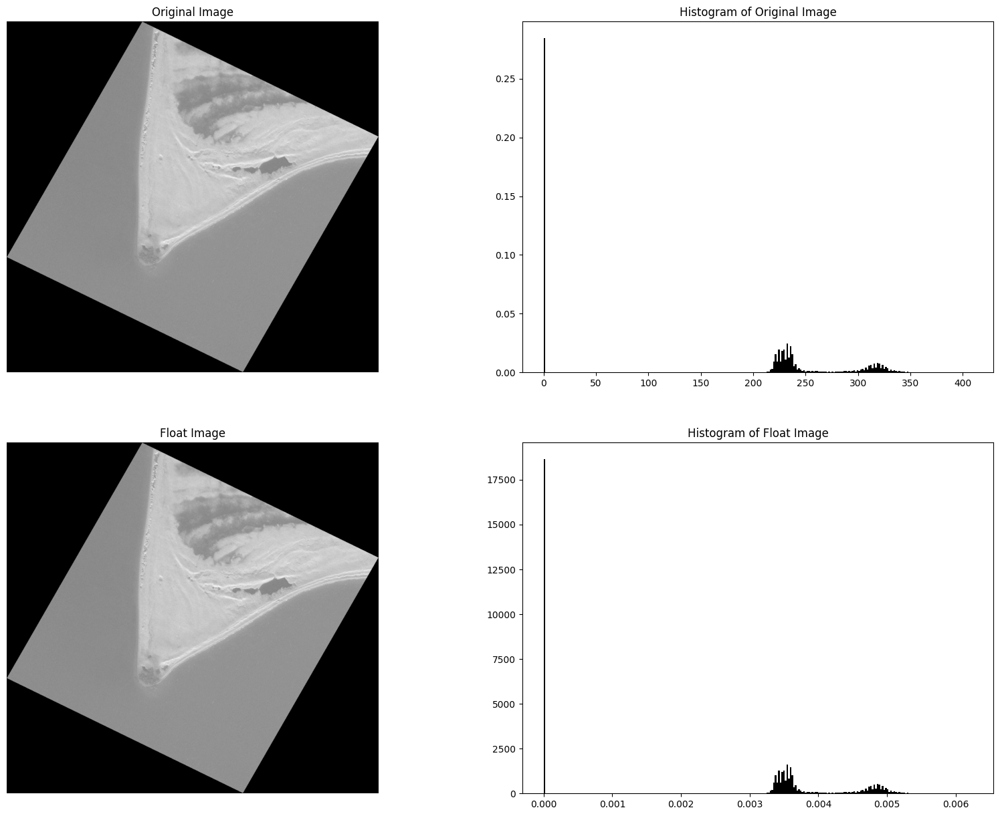

In [19]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(band1, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(band1.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(img, cmap='gray')
ax[1,0].set_title('Float Image')
ax[1,0].axis('off')
ax[1,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Float Image')
plt.show()

In [20]:
gammaEn1 = exposure.adjust_gamma(img, gamma=0.2, gain=1)

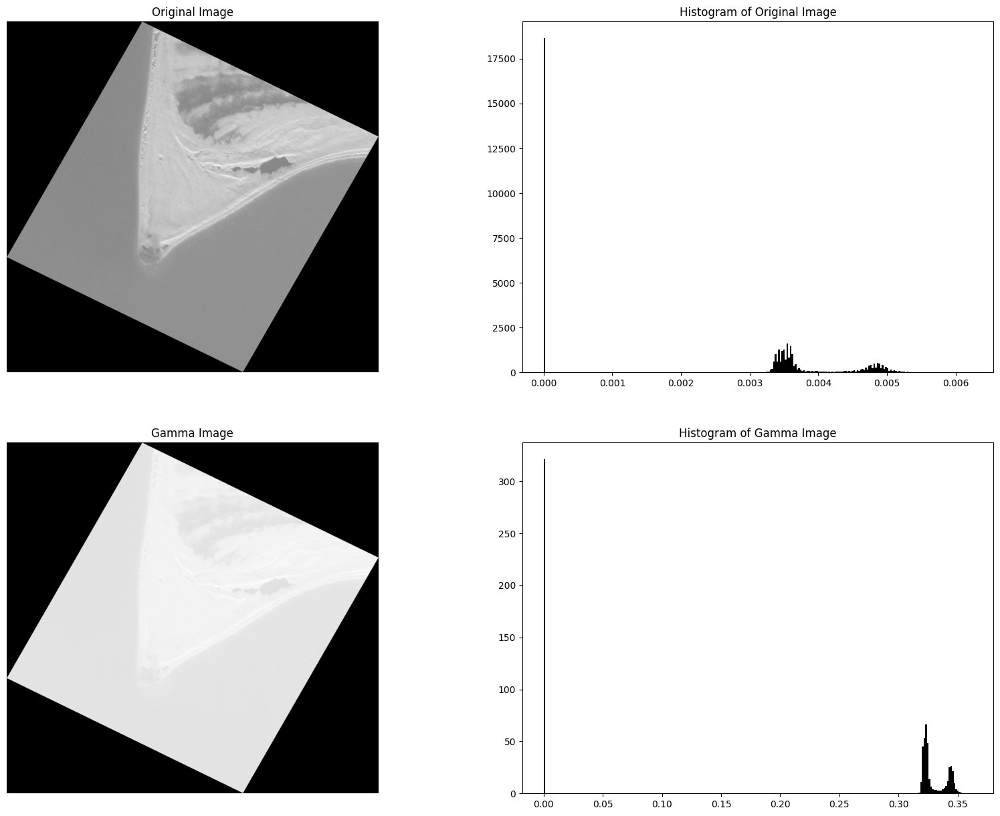

In [21]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(gammaEn1, cmap='gray')
ax[1,0].set_title('Gamma Image')
ax[1,0].axis('off')
ax[1,1].hist(gammaEn1.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Gamma Image')
plt.show()

In [84]:
img.mean() < gammaEn1.mean()

True

In [85]:
gammaEn2 = exposure.adjust_gamma(img, gamma=0.5, gain=1)

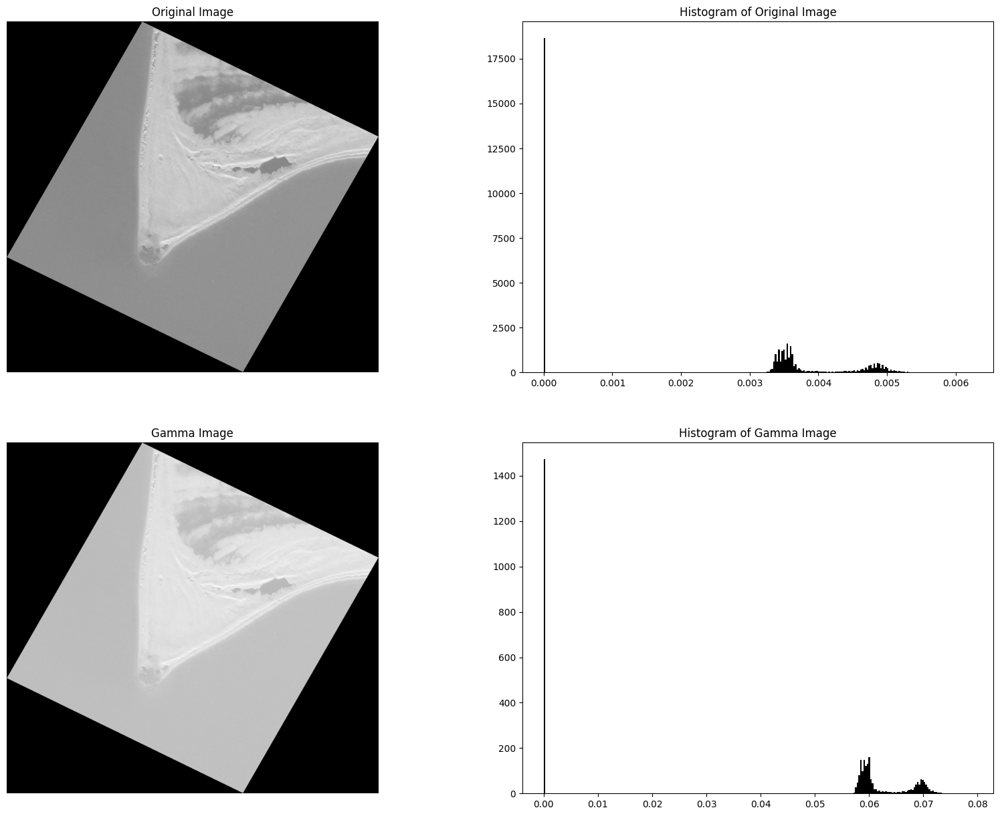

In [86]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(gammaEn2, cmap='gray')
ax[1,0].set_title('Gamma Image')
ax[1,0].axis('off')
ax[1,1].hist(gammaEn2.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Gamma Image')
plt.show()

In [87]:
img.mean() < gammaEn2.mean()

True

In [88]:
gammaEn3 = exposure.adjust_gamma(img, gamma=1, gain=1)

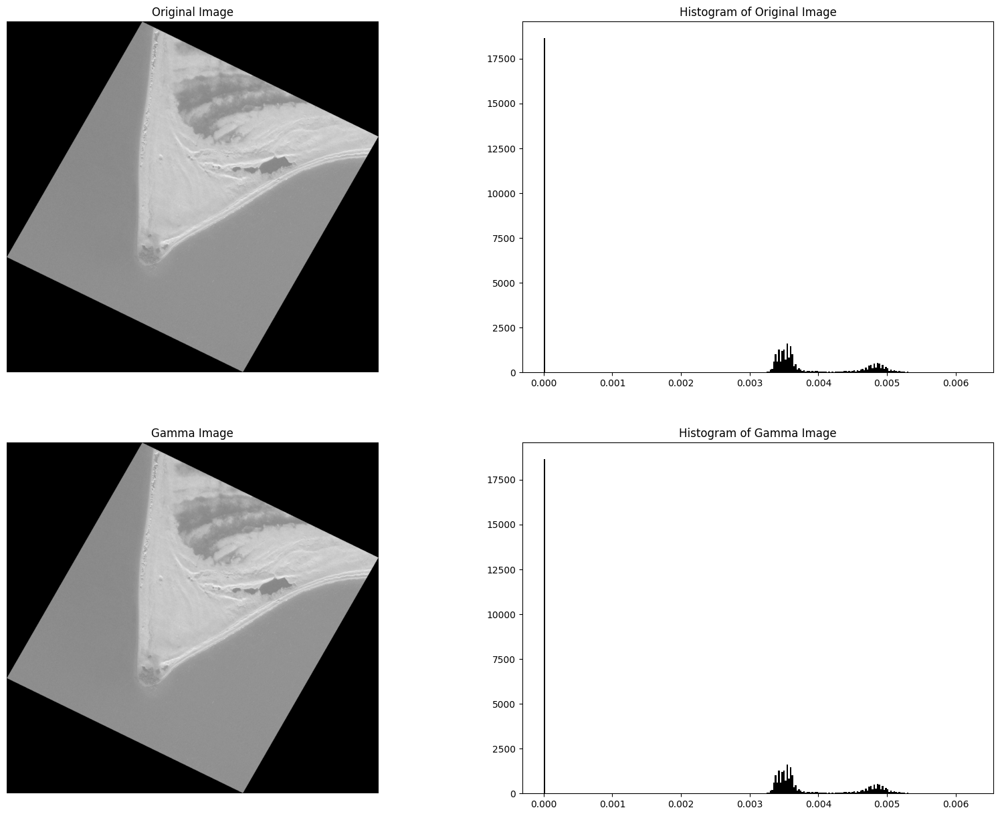

In [89]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(gammaEn3, cmap='gray')
ax[1,0].set_title('Gamma Image')
ax[1,0].axis('off')
ax[1,1].hist(gammaEn3.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Gamma Image')
plt.show()

In [90]:
img.mean() < gammaEn3.mean()

False

gamma: 0.5 > 0.2 > 1

Adjust logarithm use a logarithm for Enhancement. inv mean Inverse.

In [91]:
logEn1 = exposure.adjust_log(img, gain=1, inv=False)

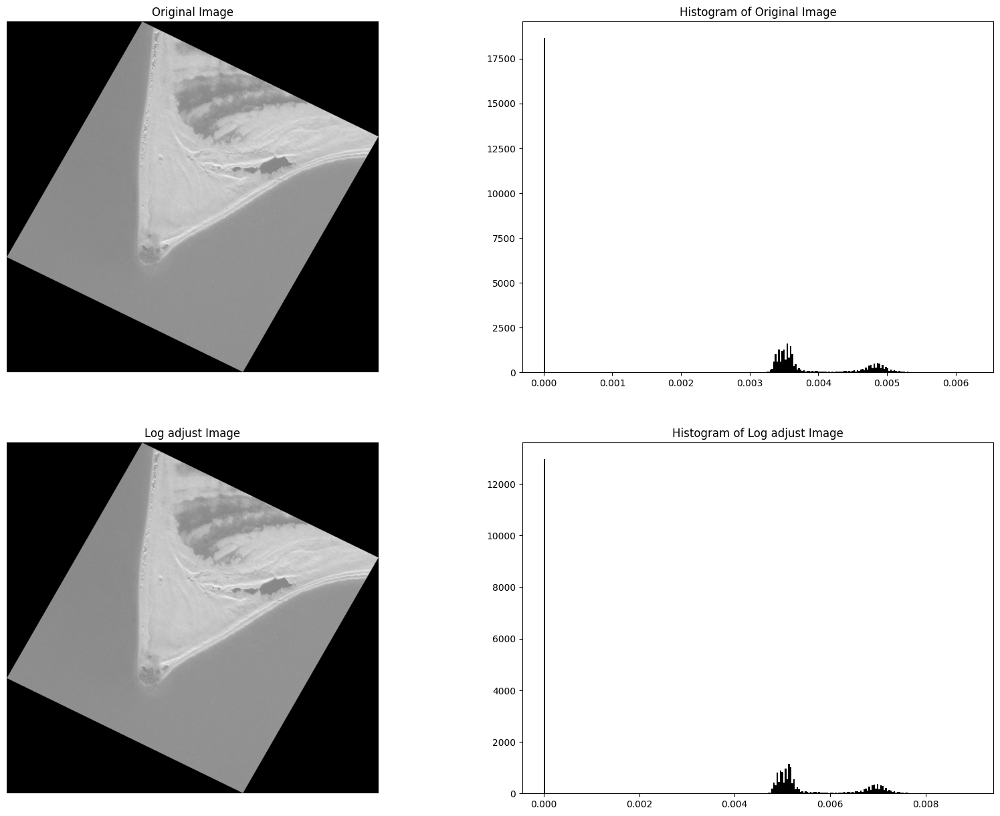

In [92]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(logEn1, cmap='gray')
ax[1,0].set_title('Log adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(logEn1.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Log adjust Image')
plt.show()

In [93]:
logEn2 = exposure.adjust_log(img, gain=1, inv=True)

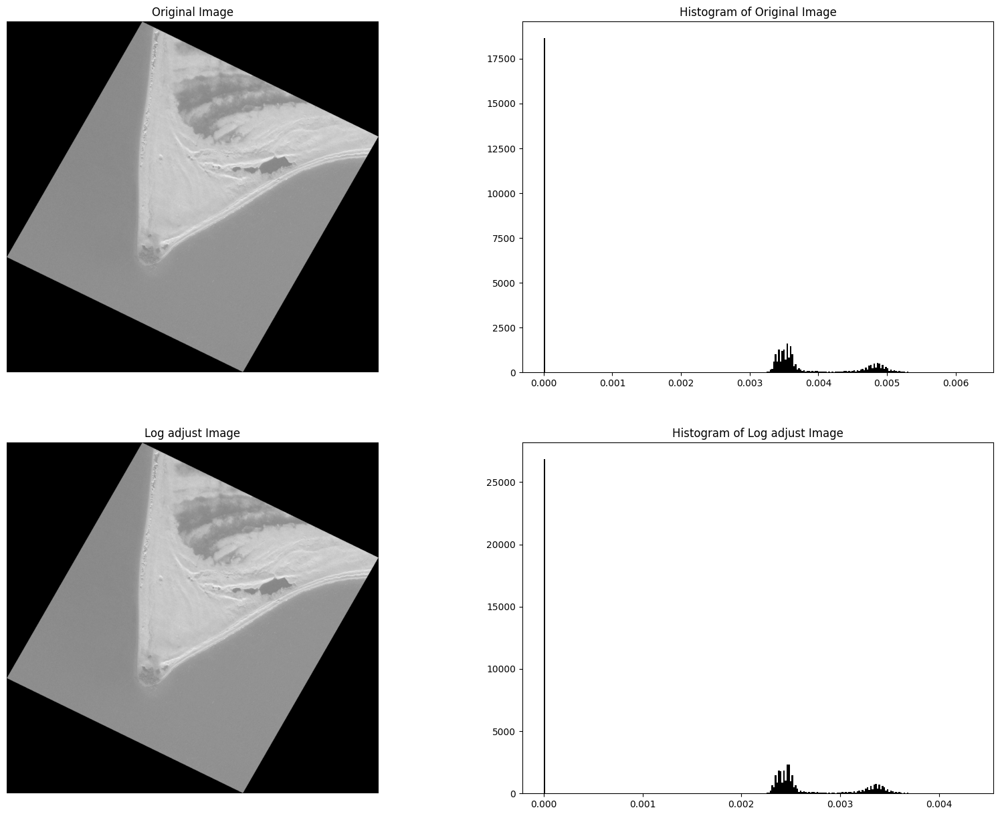

In [94]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(logEn2, cmap='gray')
ax[1,0].set_title('Log adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(logEn2.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Log adjust Image')
plt.show()

log adjust inv false > inv true . in this pic don't recommend to use log

Sigmoid is a mathematical function

In [95]:
sigmoidEn1 = exposure.adjust_sigmoid(img, cutoff=0.5, gain=10, inv=False)

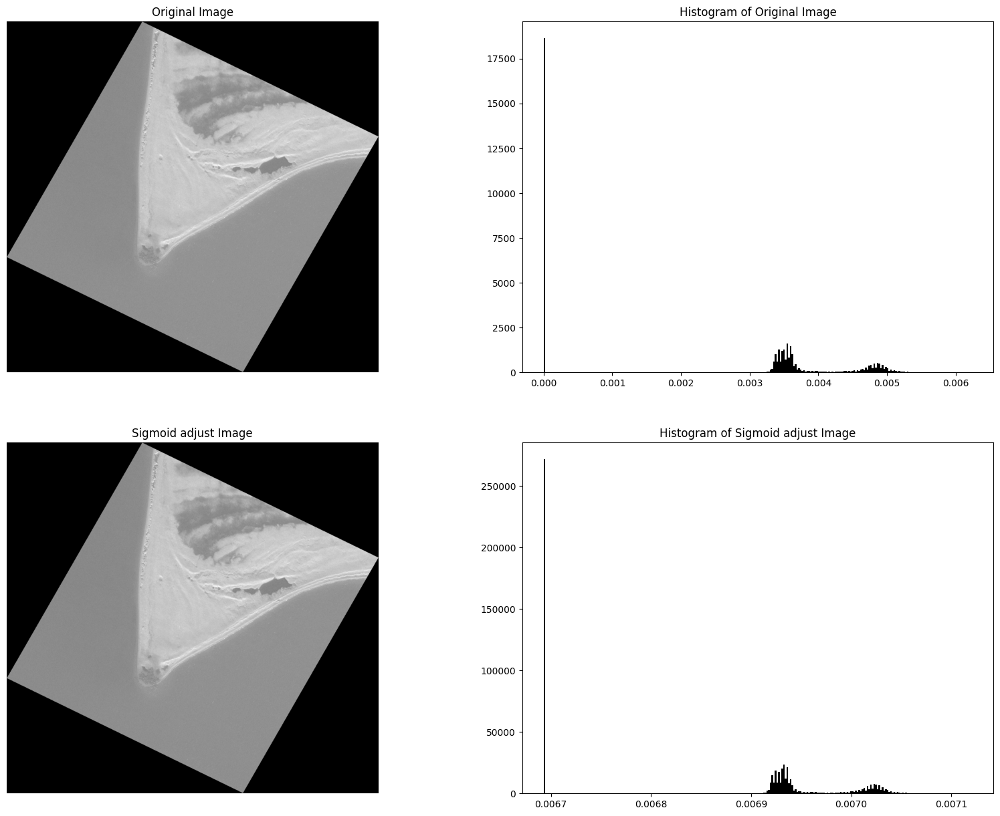

In [96]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(sigmoidEn1, cmap='gray')
ax[1,0].set_title('Sigmoid adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(sigmoidEn1.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Sigmoid adjust Image')
plt.show()

In [97]:
sigmoidEn2 = exposure.adjust_sigmoid(img, cutoff=0.9, gain=10, inv=False)

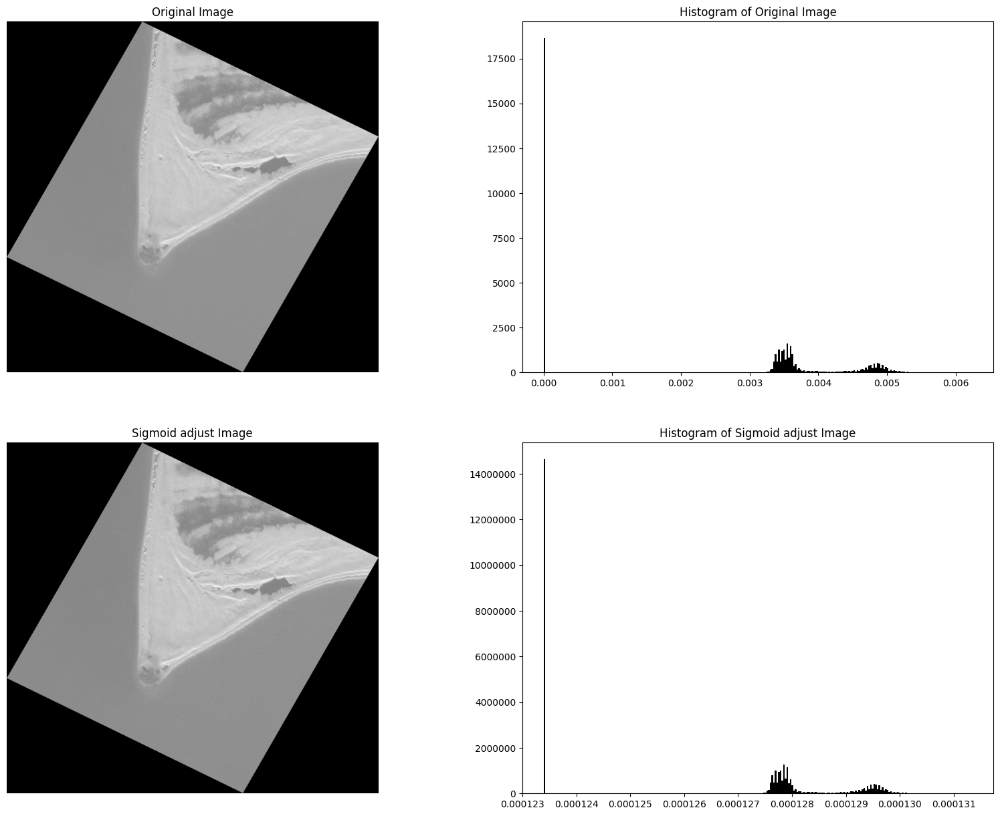

In [98]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(sigmoidEn2, cmap='gray')
ax[1,0].set_title('Sigmoid adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(sigmoidEn2.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Sigmoid adjust Image')
plt.show()

In [99]:
sigmoidEn3 = exposure.adjust_sigmoid(img, cutoff=0.05, gain=10, inv=False)

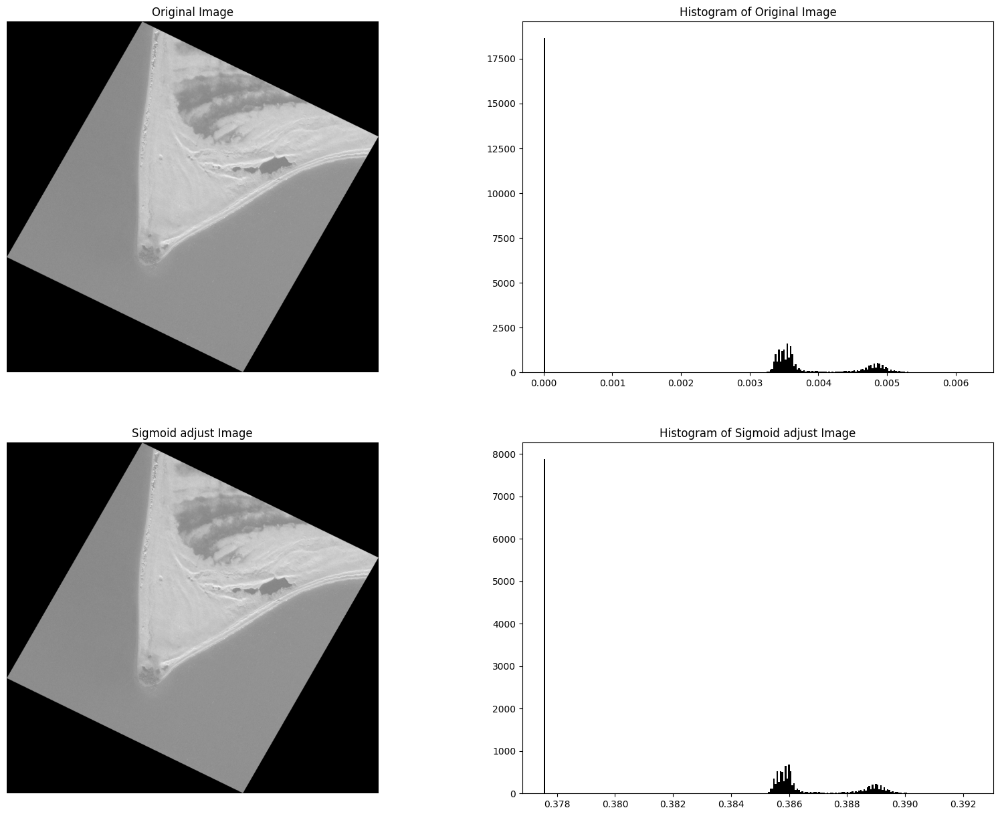

In [100]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(sigmoidEn3, cmap='gray')
ax[1,0].set_title('Sigmoid adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(sigmoidEn3.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Sigmoid adjust Image')
plt.show()

In [101]:
sigmoidEn4 = exposure.adjust_sigmoid(img, cutoff=0.1, gain=5, inv=False)

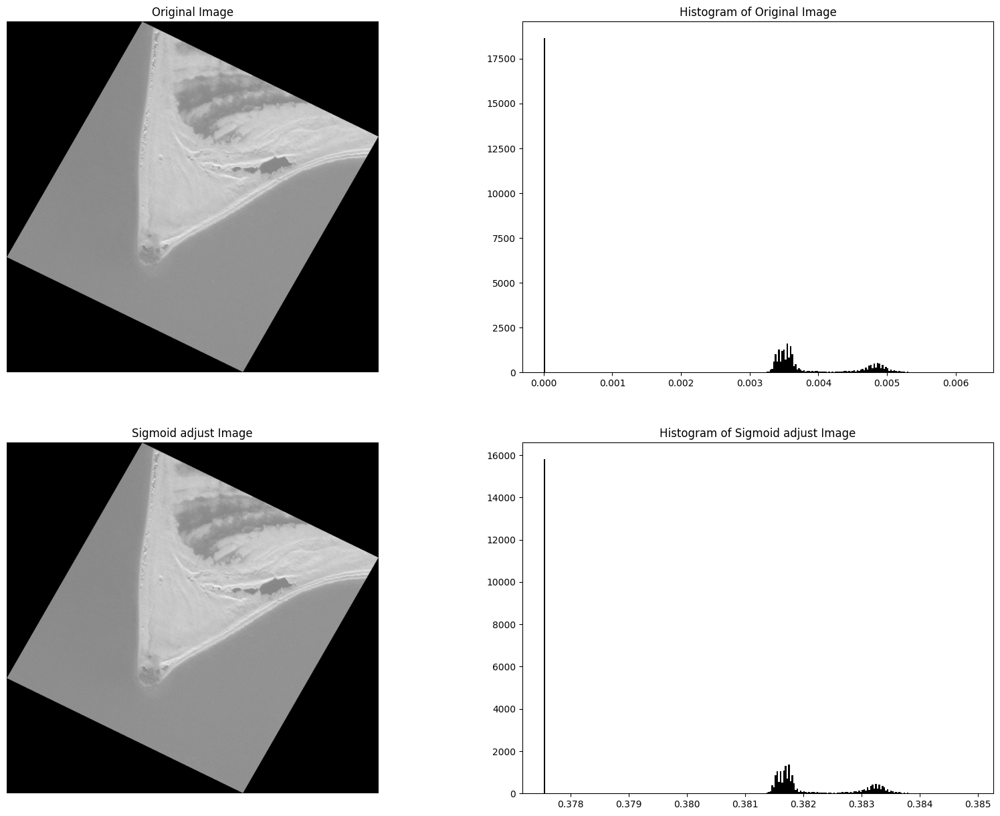

In [102]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(sigmoidEn4, cmap='gray')
ax[1,0].set_title('Sigmoid adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(sigmoidEn4.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Sigmoid adjust Image')
plt.show()

In [103]:
sigmoidEn5 = exposure.adjust_sigmoid(img, cutoff=0.1, gain=5, inv=True)

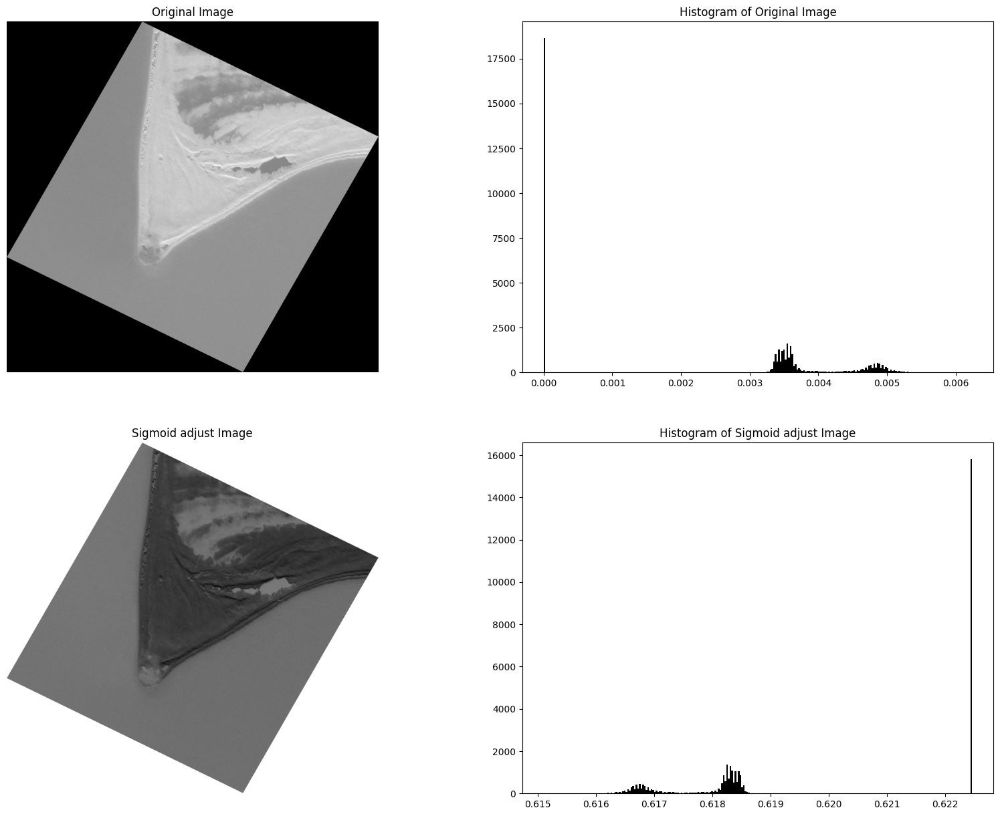

In [104]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(sigmoidEn5, cmap='gray')
ax[1,0].set_title('Sigmoid adjust Image')
ax[1,0].axis('off')
ax[1,1].hist(sigmoidEn5.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Sigmoid adjust Image')
plt.show()

adaptive is a local enhancement

In [22]:
adaptiveEn1 = exposure.equalize_adapthist(img , clip_limit=0.08, nbins=256)

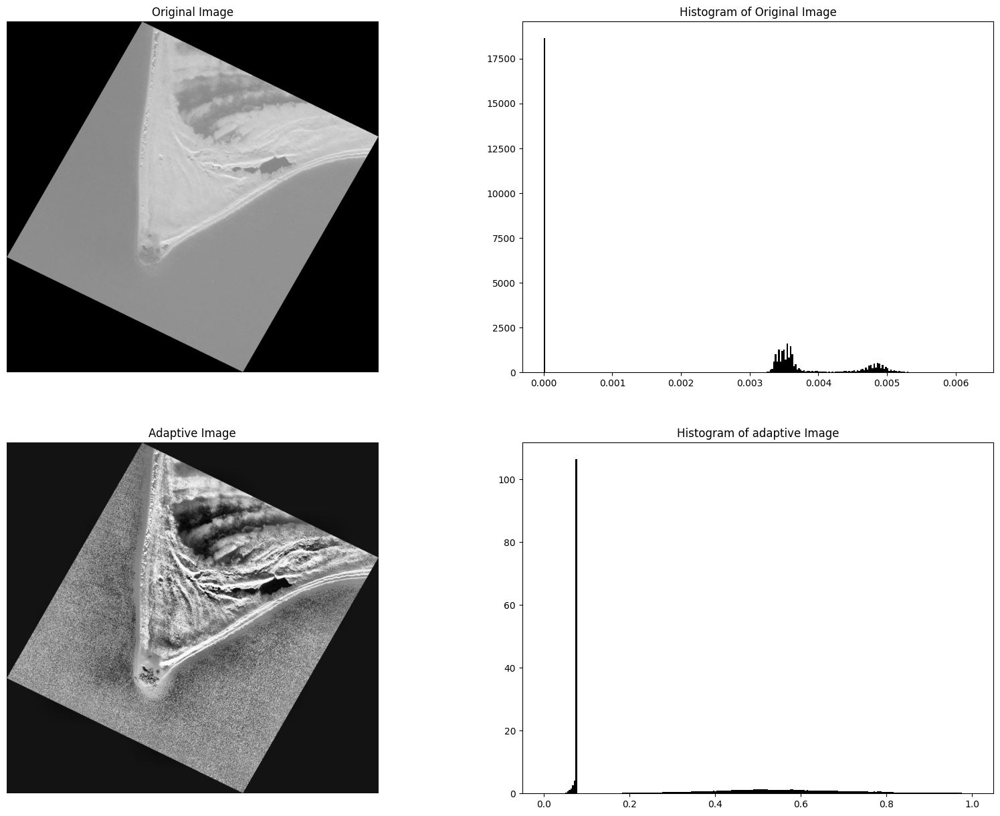

In [23]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(adaptiveEn1, cmap='gray')
ax[1,0].set_title('Adaptive Image')
ax[1,0].axis('off')
ax[1,1].hist(adaptiveEn1.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of adaptive Image')
plt.show()

In [107]:
adaptiveEn2 = exposure.equalize_adapthist(img , clip_limit=0.9, nbins=256)

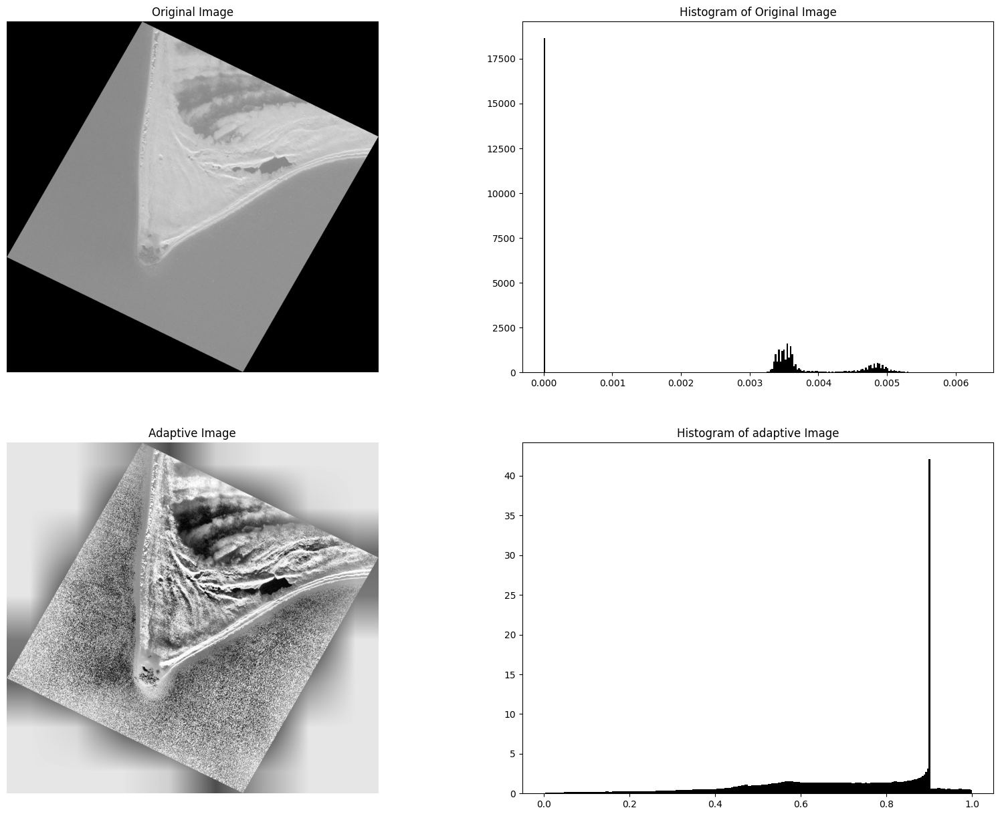

In [108]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(adaptiveEn2, cmap='gray')
ax[1,0].set_title('Adaptive Image')
ax[1,0].axis('off')
ax[1,1].hist(adaptiveEn2.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of adaptive Image')
plt.show()

In [109]:
adaptiveEn3 = exposure.equalize_adapthist(img , clip_limit=0.02, nbins=256)

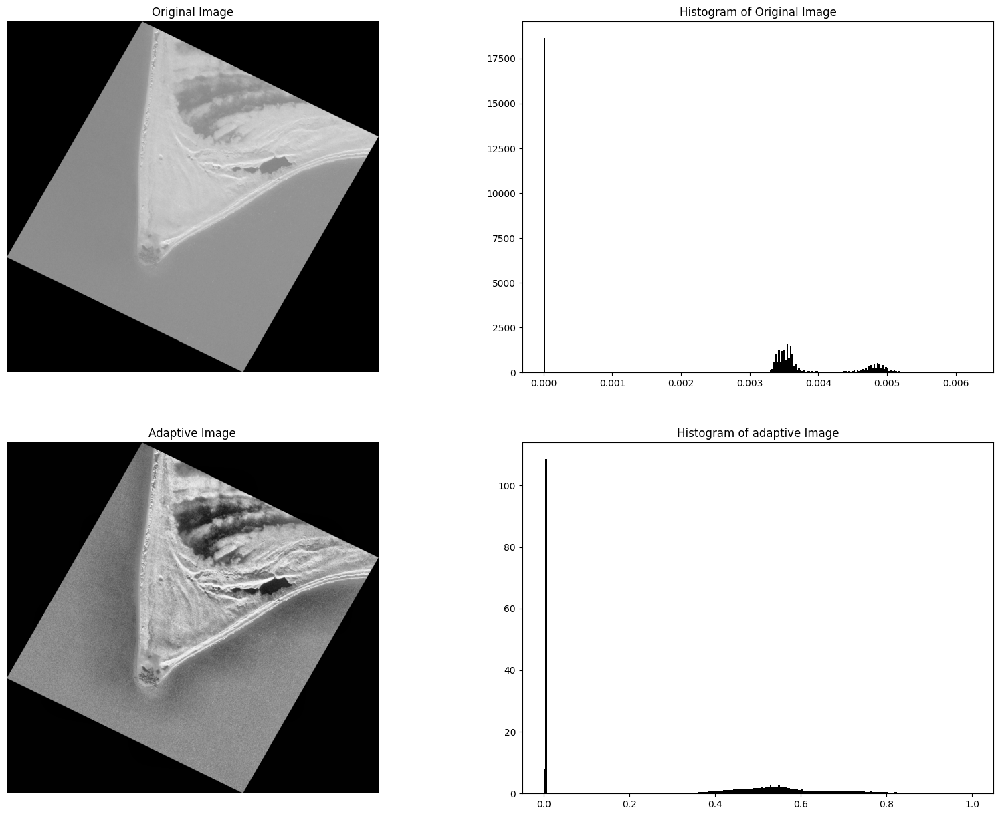

In [110]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(adaptiveEn3, cmap='gray')
ax[1,0].set_title('Adaptive Image')
ax[1,0].axis('off')
ax[1,1].hist(adaptiveEn3.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of adaptive Image')
plt.show()

equalize histogram change histogram totally

In [111]:
equalizeEn = exposure.equalize_hist(img, nbins=256, mask=None)

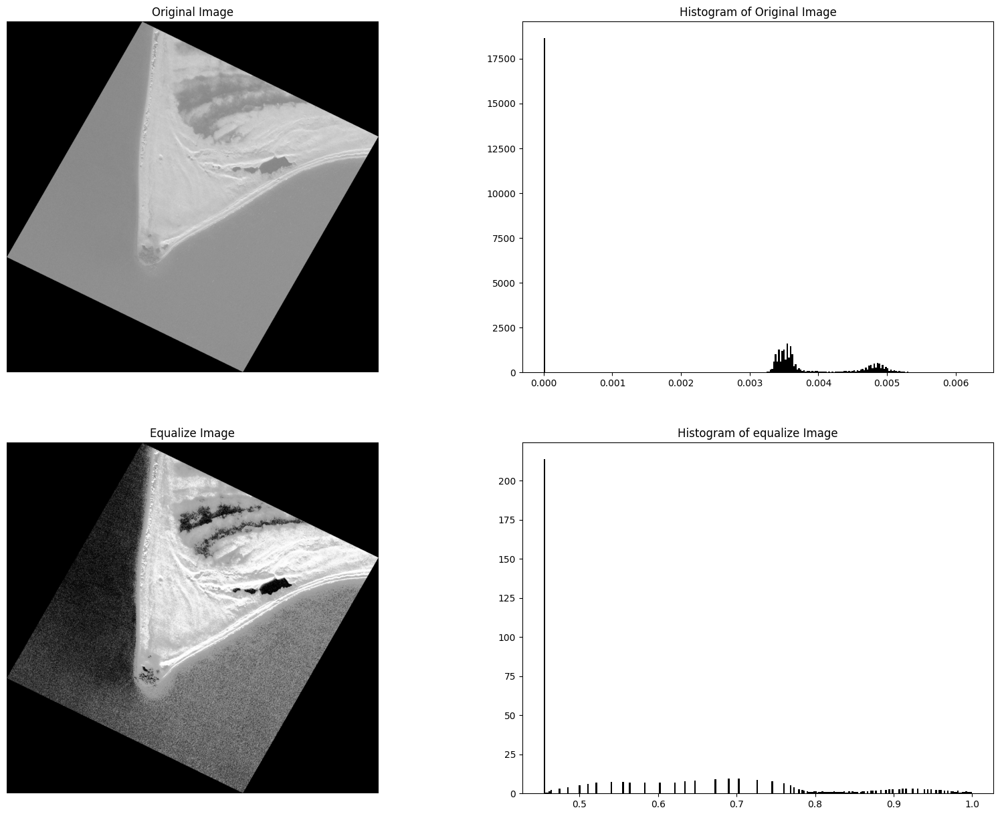

In [112]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(img, cmap='gray')
ax[0,0].set_title('Original Image')
ax[0,0].axis('off')
ax[0,1].hist(img.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of Original Image')
######################################################
ax[1,0].imshow(equalizeEn, cmap='gray')
ax[1,0].set_title('Equalize Image')
ax[1,0].axis('off')
ax[1,1].hist(equalizeEn.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of equalize Image')
plt.show()


Image Enhancement methods in skimage 
exposure.adjust_gamma(img, gamma=0.7, gain=1) exposure.adjust_log(img, gain=1, inv=False) exposure.adjust_sigmoid(img, cutoff=0.1, gain=5, inv=False) exposure.equalize_adapthist(img , clip_limit=0.01, nbins=256) exposure.equalize_hist(img, nbins=256, mask=None)

test

In [24]:
# Open the clipped image
with rasterio.open(clipped_image_path) as dataset:
    # Read Bands from the clipped image
    blue  = dataset.read(1)
    green = dataset.read(2)
    red   = dataset.read(3)
    NIR   = dataset.read(4)
    

In [25]:
B1 = np.array(blue).astype(float)
B2 = np.array(green).astype(float)
B3 = np.array(red).astype(float)
B4 = np.array(NIR).astype(float)

In [26]:
NB3 = (B3-np.min(B3))/(np.max(B3)-np.min(B3))
NB2 = (B2-np.min(B2))/(np.max(B2)-np.min(B2))
NB1 = (B1-np.min(B1))/(np.max(B1)-np.min(B1))

In [27]:
Nstack = np.stack([NB3,NB2,NB1], axis=2)

In [28]:
equalizeEnNB1 = exposure.equalize_hist(NB1, nbins=256, mask=None)
equalizeEnNB2 = exposure.equalize_hist(NB2, nbins=256, mask=None)
equalizeEnNB3 = exposure.equalize_hist(NB3, nbins=256, mask=None)

equalizeNstack = np.stack([equalizeEnNB3,equalizeEnNB2,equalizeEnNB1], axis=2)

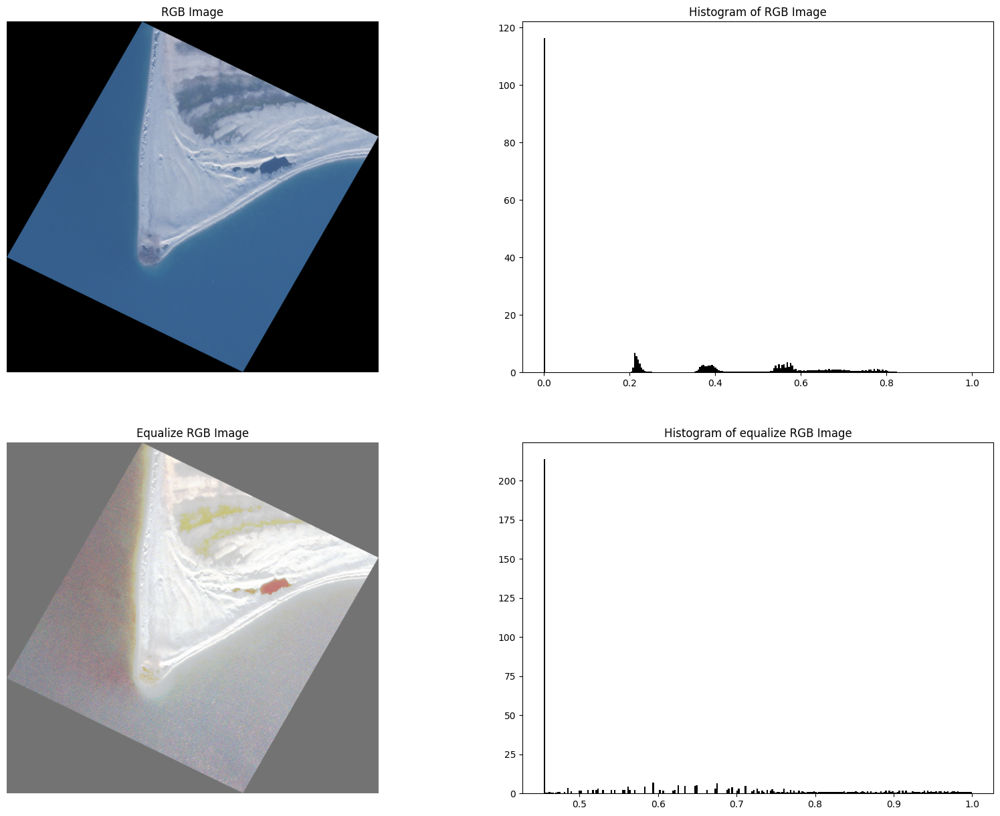

In [29]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(Nstack)
ax[0,0].set_title('RGB Image')
ax[0,0].axis('off')
ax[0,1].hist(Nstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of RGB Image')
######################################################
ax[1,0].imshow(equalizeNstack, cmap='gray')
ax[1,0].set_title('Equalize RGB Image')
ax[1,0].axis('off')
ax[1,1].hist(equalizeNstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of equalize RGB Image')
plt.show()

In [30]:
adaptiveEnNB1 = exposure.equalize_adapthist(NB1 , clip_limit=0.08, nbins=256)
adaptiveEnNB2 = exposure.equalize_adapthist(NB2 , clip_limit=0.08, nbins=256)
adaptiveEnNB3 = exposure.equalize_adapthist(NB3 , clip_limit=0.08, nbins=256)
adaptiveNstack = np.stack([adaptiveEnNB3,adaptiveEnNB2,adaptiveEnNB1], axis=2)

Text(0.5, 1.0, 'Histogram of adaptive RGB Image')

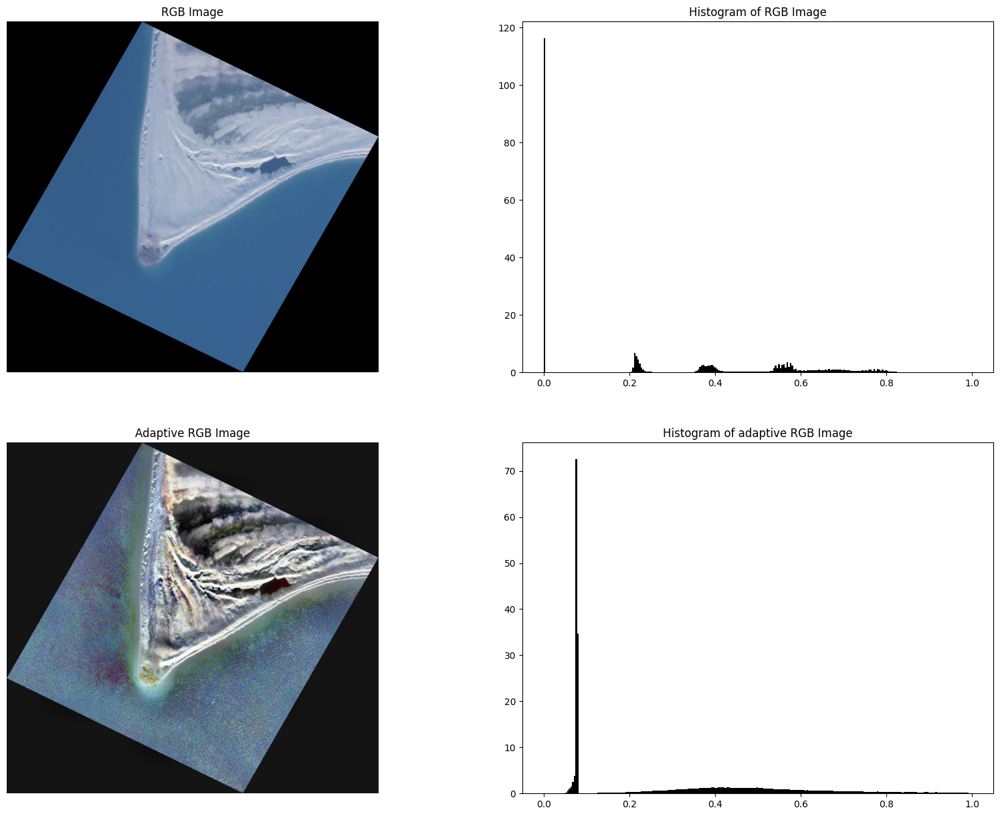

In [31]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(Nstack)
ax[0,0].set_title('RGB Image')
ax[0,0].axis('off')
ax[0,1].hist(Nstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of RGB Image')
######################################################
ax[1,0].imshow(adaptiveNstack, cmap='gray')
ax[1,0].set_title('Adaptive RGB Image')
ax[1,0].axis('off')
ax[1,1].hist(adaptiveNstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of adaptive RGB Image')

This works really well! very clear! test on low res now, different bands need to adapt method

In [32]:
GEnNB1 = exposure.adjust_gamma(NB1 , gamma=0.5, gain=1)
GEnNB2 = exposure.adjust_gamma(NB2 , gamma=0.5, gain=1)
GEnNB3 = exposure.adjust_gamma(NB3 , gamma=0.5, gain=1)
GNstack = np.stack([GEnNB3,GEnNB2,GEnNB1], axis=2)

Text(0.5, 1.0, 'Histogram of Gamma RGB Image')

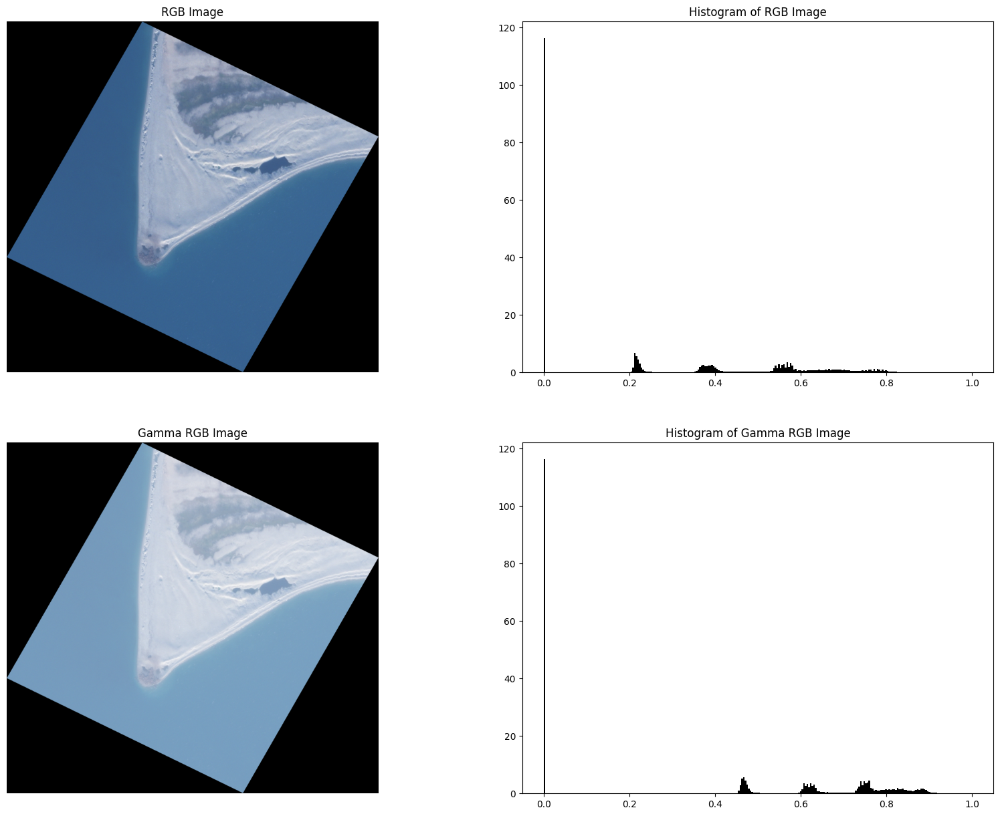

In [33]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(Nstack)
ax[0,0].set_title('RGB Image')
ax[0,0].axis('off')
ax[0,1].hist(Nstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of RGB Image')
######################################################
ax[1,0].imshow(GNstack, cmap='gray')
ax[1,0].set_title('Gamma RGB Image')
ax[1,0].axis('off')
ax[1,1].hist(GNstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Gamma RGB Image')

In [34]:
GEnNB1 = exposure.adjust_gamma(NB1 , gamma=0.5, gain=1)
GEnNB2 = exposure.adjust_gamma(NB2 , gamma=0.5, gain=1)
GEnNB3 = exposure.adjust_gamma(NB3 , gamma=0.5, gain=1)
GNstack = np.stack([GEnNB3,GEnNB2,GEnNB1], axis=2)

Text(0.5, 1.0, 'Histogram of Gamma RGB Image')

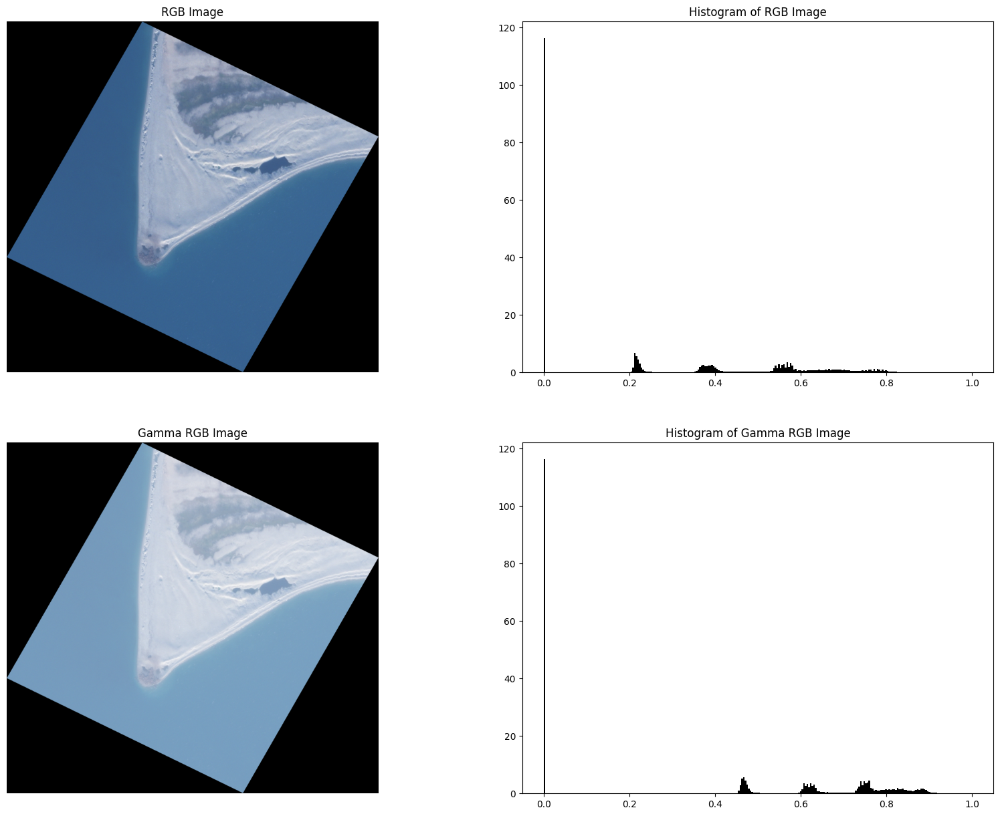

In [35]:
fig , ax = plt.subplots(nrows=2, ncols=2, figsize=(20,15))
ax[0,0].imshow(Nstack)
ax[0,0].set_title('RGB Image')
ax[0,0].axis('off')
ax[0,1].hist(Nstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[0,1].ticklabel_format(style='plain')
ax[0,1].set_title('Histogram of RGB Image')
######################################################
ax[1,0].imshow(GNstack, cmap='gray')
ax[1,0].set_title('Gamma RGB Image')
ax[1,0].axis('off')
ax[1,1].hist(GNstack.ravel(), bins=256, density=True, histtype='bar', color='black')
ax[1,1].ticklabel_format(style='plain')
ax[1,1].set_title('Histogram of Gamma RGB Image')

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from skimage.color import rgb2hsv
from skimage import io
import imagecodecs

In [30]:
NB4 = (B4 - np.min(B4)) / (np.max(B4) - np.min(B4))
NB3 = (B3 - np.min(B3)) / (np.max(B3) - np.min(B3))
NB2 = (B2 - np.min(B2)) / (np.max(B2) - np.min(B2))
NB1 = (B1 - np.min(B1)) / (np.max(B1) - np.min(B1))

In [31]:
img = np.dstack((NB3,NB2,NB1)) 

In [38]:
irimg = np.dstack((NB4, NB3, NB2))

In [34]:
hsv = rgb2hsv(img)

In [39]:
irhsv = rgb2hsv(irimg)

In [40]:
hue = hsv[:,:,0]
saturation = hsv[:,:,1]
value = hsv[:,:,2]

In [41]:
irhue = irhsv[:,:,0]
irsaturation = irhsv[:,:,1]
irvalue = irhsv[:,:,2]

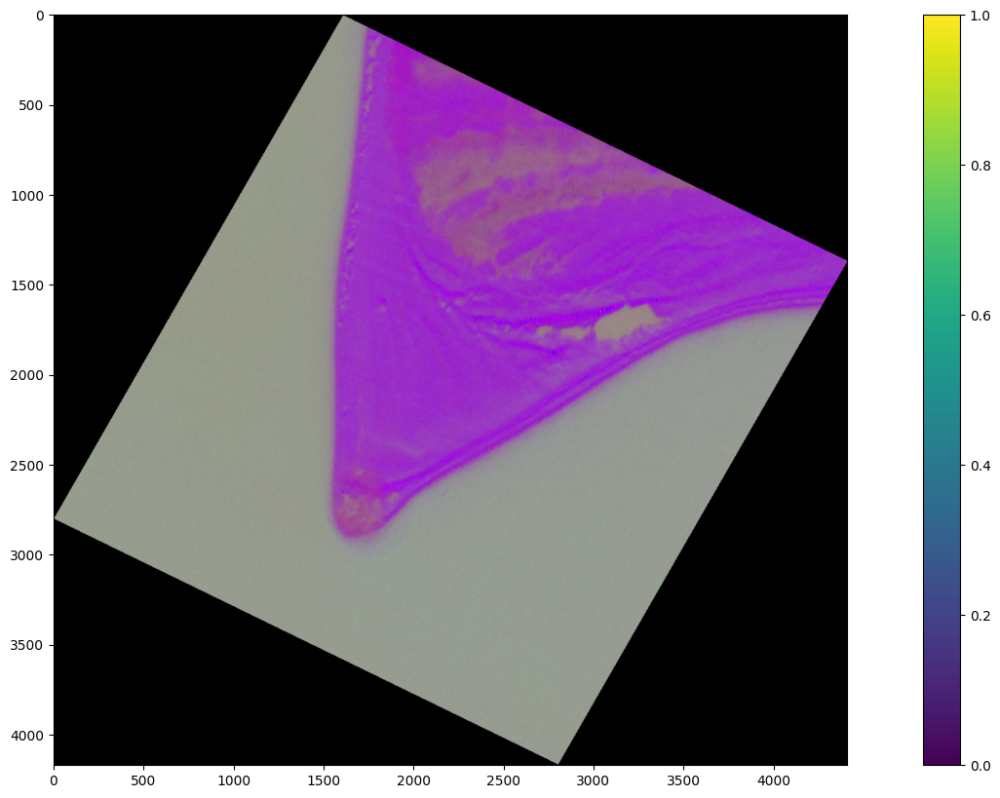

In [42]:
plt.figure(figsize=(20,10))
plt.imshow(hsv)
plt.colorbar()
plt.show()

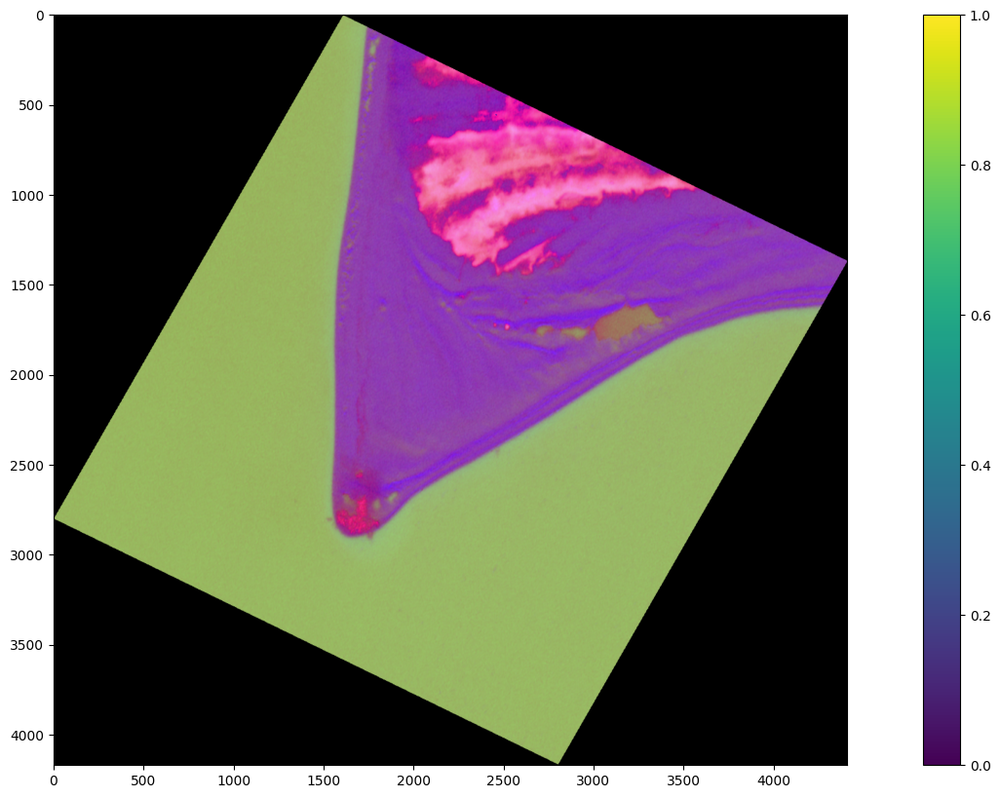

In [43]:
plt.figure(figsize=(20,10))
plt.imshow(irhsv)
plt.colorbar()
plt.show()

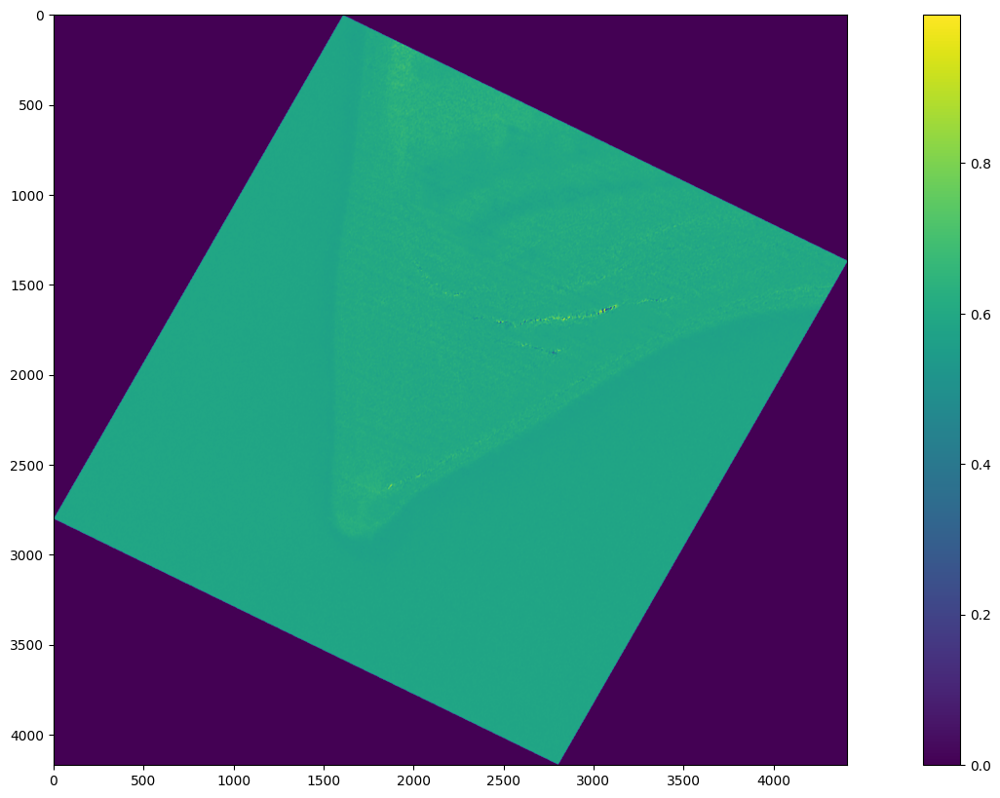

In [44]:
plt.figure(figsize=(20,10))
plt.imshow(hue)
plt.colorbar()
plt.show()

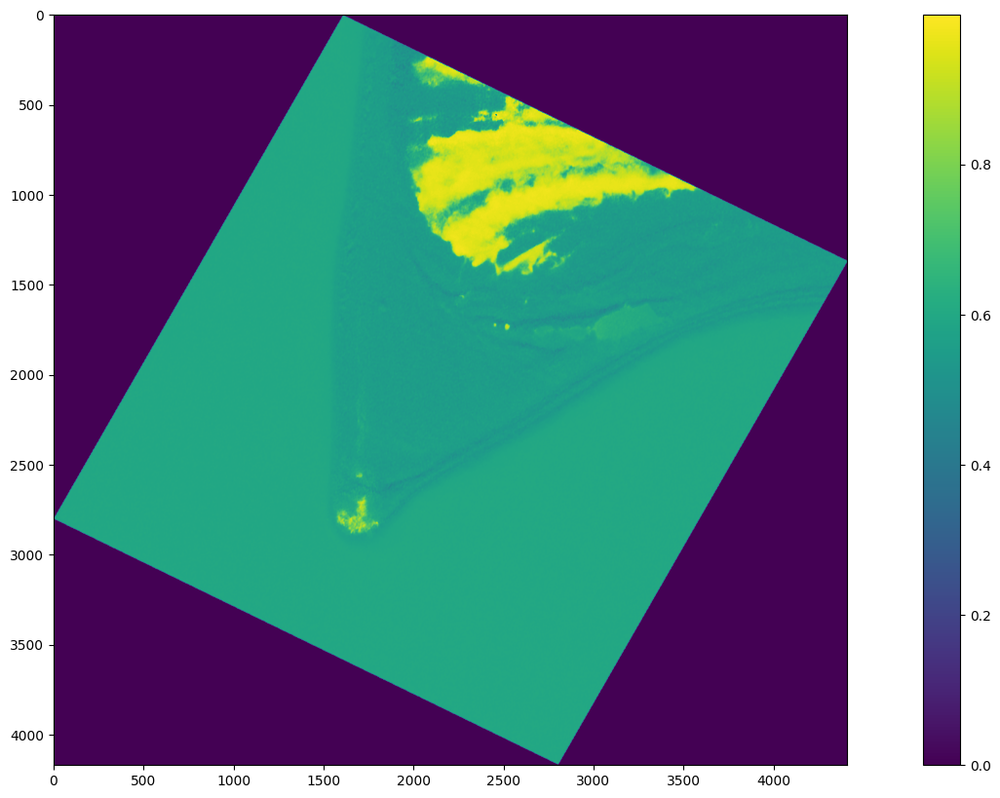

In [45]:
plt.figure(figsize=(20,10))
plt.imshow(irhue)
plt.colorbar()
plt.show()

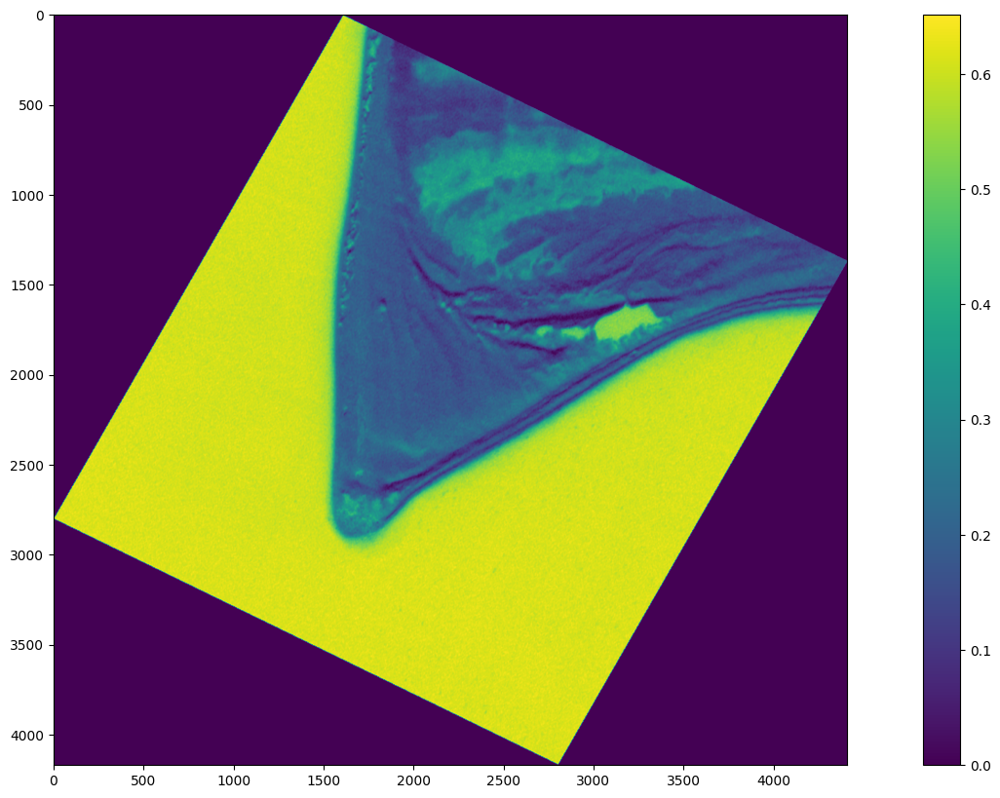

In [46]:
plt.figure(figsize=(20,10))
plt.imshow(saturation)
plt.colorbar()
plt.show()

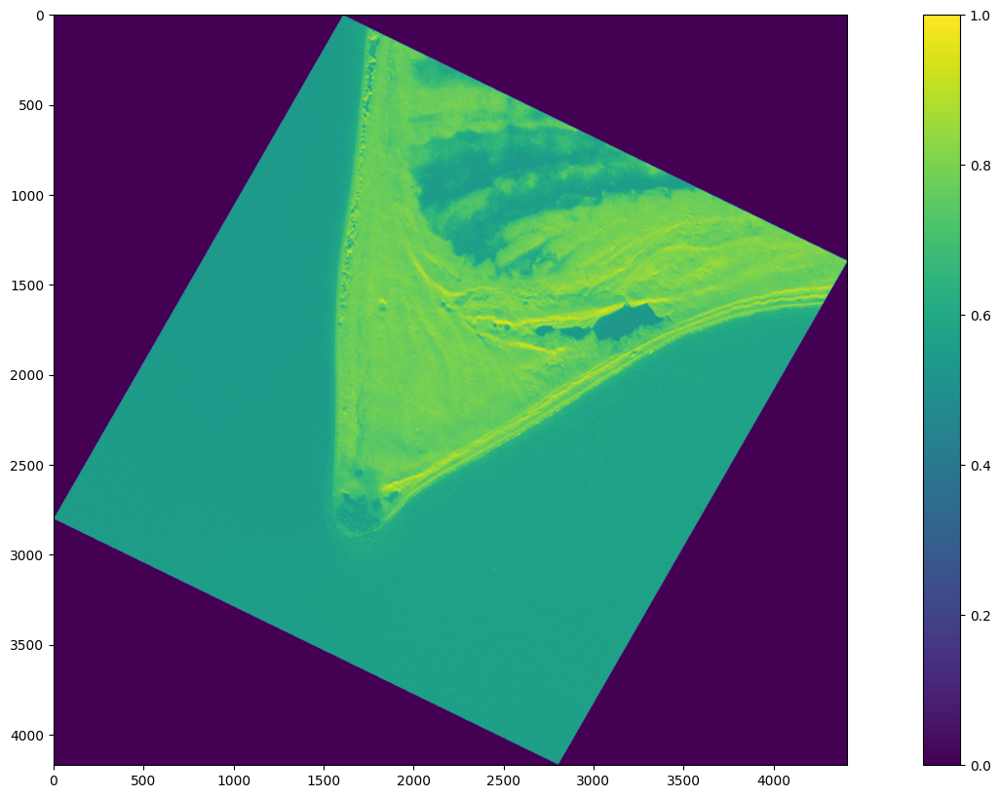

In [47]:
plt.figure(figsize=(20,10))
plt.imshow(value)
plt.colorbar()
plt.show()

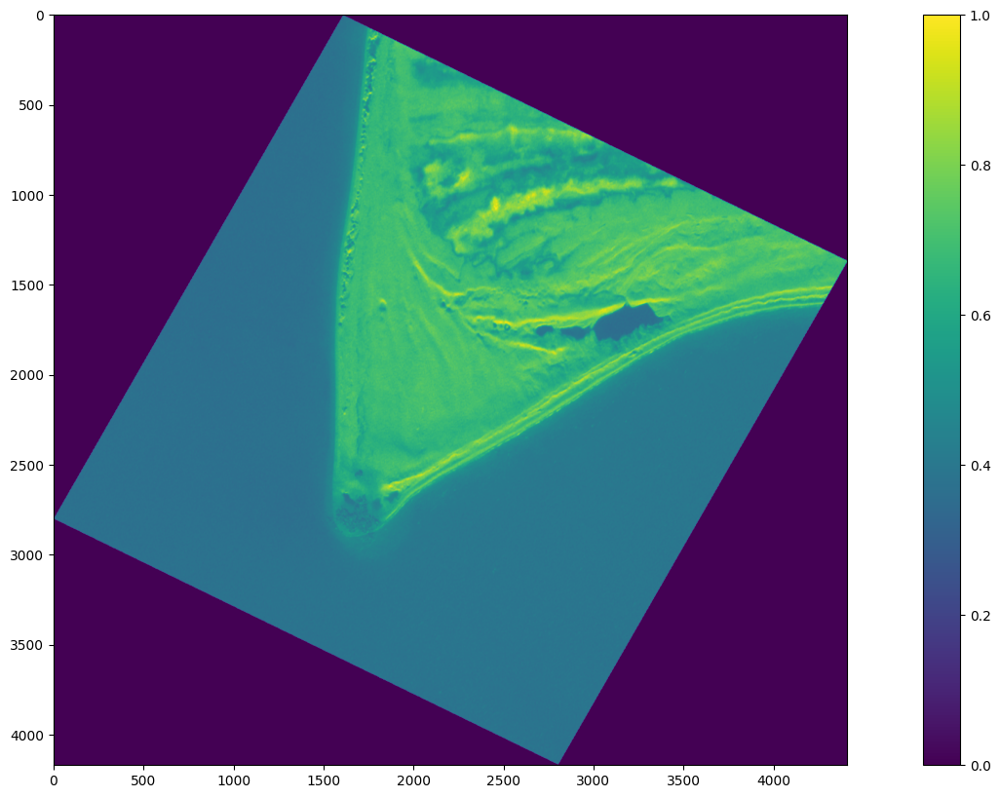

In [48]:
plt.figure(figsize=(20,10))
plt.imshow(irvalue)
plt.colorbar()
plt.show()

Debug bug bug 